In [32]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy
pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_6_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"
ocean_daily_wave_1= xr.open_dataset(pp_root_uncou+"20040101_results/20040101.ocean_daily.nc")
model_grid_x = ocean_daily_wave_1.variables['xh']
model_grid_y = ocean_daily_wave_1.variables['yh']
LA_MOD=ocean_daily_wave_1['La_turbulent'][150,:,:]

LA_MOD.plot(vmin=0,vmax=1)

KeyError: 'La_turbulent'

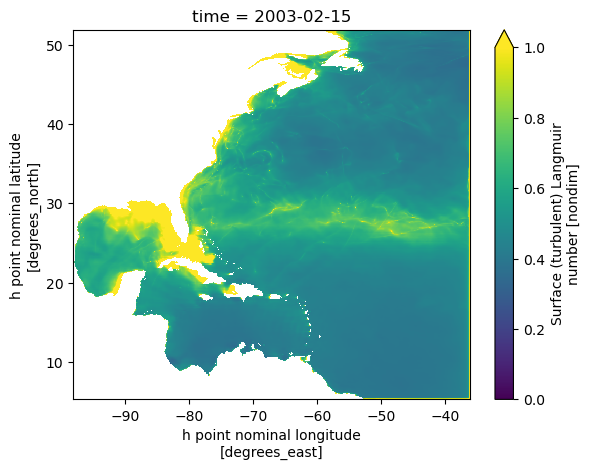

In [31]:
ocean_daily_wave_1= xr.open_dataset(pp_root_6_wave+"20030101_results/20030101.ocean_month.nc")
model_grid_x = ocean_daily_wave_1.variables['xh']
model_grid_y = ocean_daily_wave_1.variables['yh']
LA_MOD=ocean_daily_wave_1['La_turbulent'][1,:,:]

LA_MOD.plot(vmin=0,vmax=1)

In [6]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_6_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"
def read_and_extract_data(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        datasets = []
        summer_data_list = []
        winter_data_list = []

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        yearly_mean=ds[var_name].mean('time')
                        datasets.append(yearly_mean)

                        # Summer: June, July, August (JJA)
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        if not summer[var_name].isnull().all():
                            summer_mean=summer[var_name].mean('time')
                            summer_data_list.append(summer_mean)

                        # Winter: December, January, February (DJF)
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        if not winter[var_name].isnull().all():
                            winter_mean=winter[var_name].mean('time')
                            winter_data_list.append(winter_mean)

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Combine along time dimension after the loop finishes
        combined_data[var_name] = xr.concat(datasets, dim='time') if datasets else None
        summer_data[var_name] = xr.concat(summer_data_list, dim='time') if summer_data_list else None
        winter_data[var_name] = xr.concat(winter_data_list, dim='time') if winter_data_list else None

    return combined_data, summer_data, winter_data

Ddata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    # '20040101_results/20040101.ocean_daily.nc',
    # '20050101_results/20050101.ocean_daily.nc',
    # '20060101_results/20060101.ocean_daily.nc',
    # '20070101_results/20070101.ocean_daily.nc',
    # '20080101_results/20080101.ocean_daily.nc',
    # '20090101_results/20090101.ocean_daily.nc',
    # '20100101_results/20100101.ocean_daily.nc',
    # '20110101_results/20110101.ocean_daily.nc',
    # '20120101_results/20120101.ocean_daily.nc',
    # '20130101_results/20130101.ocean_daily.nc',
    # '20140101_results/20140101.ocean_daily.nc',
    # '20150101_results/20150101.ocean_daily.nc',
    # '20160101_results/20160101.ocean_daily.nc',
    # '20170101_results/20170101.ocean_daily.nc',
    # '20180101_results/20180101.ocean_daily.nc',
    # '20190101_results/20190101.ocean_daily.nc',
    # '20200101_results/20200101.ocean_daily.nc',
    # '20210101_results/20210101.ocean_daily.nc',
    # '20220101_results/20220101.ocean_daily.nc',

]

Mdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    # '20040101_results/20040101.ocean_month.nc',
    # '20050101_results/20050101.ocean_month.nc',
    # '20060101_results/20060101.ocean_month.nc',
    # '20070101_results/20070101.ocean_month.nc',
    # '20080101_results/20080101.ocean_month.nc',
    # '20090101_results/20090101.ocean_month.nc',
    # '20100101_results/20100101.ocean_month.nc',
    # '20110101_results/20110101.ocean_month.nc',
    # '20120101_results/20120101.ocean_month.nc',
    # '20130101_results/20130101.ocean_month.nc',
    # '20140101_results/20140101.ocean_month.nc',
    # '20150101_results/20150101.ocean_month.nc',
    # '20160101_results/20160101.ocean_month.nc',
    # '20170101_results/20170101.ocean_month.nc',
    # '20180101_results/20180101.ocean_month.nc',
    # '20190101_results/20190101.ocean_month.nc',
    # '20200101_results/20200101.ocean_month.nc',
    # '20210101_results/20210101.ocean_month.nc',
    # '20220101_results/20220101.ocean_month.nc',

]
WMdata_list = [
    '19930101_results/19930101.ocean_month.nc',
    '19930701_results/19930701.ocean_month.nc',
    '19940101_results/19940101.ocean_month.nc',
    '19940701_results/19940701.ocean_month.nc',
    '19950101_results/19950101.ocean_month.nc',
    '19950701_results/19950701.ocean_month.nc',
    '19960101_results/19960101.ocean_month.nc',
    '19960701_results/19960701.ocean_month.nc',
    '19970101_results/19970101.ocean_month.nc',
    '19970701_results/19970701.ocean_month.nc',
    '19980101_results/19980101.ocean_month.nc',
    '19980701_results/19980701.ocean_month.nc',
    '19990101_results/19990101.ocean_month.nc',
    '19990701_results/19990701.ocean_month.nc',
    '20000101_results/20000101.ocean_month.nc',
    '20000701_results/20000701.ocean_month.nc',
    '20010101_results/20010101.ocean_month.nc',
    '20010701_results/20010701.ocean_month.nc',
    '20020101_results/20020101.ocean_month.nc',
    '20020701_results/20020701.ocean_month.nc',
    '20030101_results/20030101.ocean_month.nc',
    '20030701_results/20030701.ocean_month.nc',
]

WDdata_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19960701_results/19960701.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19970701_results/19970701.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19980701_results/19980701.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '19990701_results/19990701.ocean_daily.nc',
    '20000101_results/20000101.ocean_daily.nc',
    '20000701_results/20000701.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20010701_results/20010701.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20020701_results/20020701.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20030701_results/20030701.ocean_daily.nc',
]

# variables_month = ['ssh','speed','MLD_EN1','LA','LA_MOD','MSTAR_LT','La_turbulent','surface_stokes_x','surface_stokes_y']
variables_daily = ['SST']
variables_month = ['LA','LA_MOD','MSTAR_LT','La_turbulent']

# Dcombined_data_uncou, Dsummer_data_uncou, Dwinter_data_uncou = read_and_extract_data(pp_root_uncou, Ddata_list, variables_daily)
# Mcombined_data_uncou, Msummer_data_uncou, Mwinter_data_uncou = read_and_extract_data(pp_root_uncou, Mdata_list, variables_month)

# Dcombined_data_6_wave, Dsummer_data_6_wave, Dwinter_data_6_wave = read_and_extract_data(pp_root_6_wave, WDdata_list, variables_daily)
combined_data_6_wave, summer_data_6_wave, winter_data_6_wave = read_and_extract_data(pp_root_6_wave, WMdata_list, variables_month)

# Dcombined_data_6_all, Dsummer_data_6_all, Dwinter_data_6_all = read_and_extract_data(pp_root_6_all, WDdata_list, variables_daily)
# combined_data_6_all, summer_data_6_all, winter_data_6_all = read_and_extract_data(pp_root_6_all, WMdata_list, variables_month)


ocean_daily_uncou_1= xr.open_dataset(pp_root_uncou+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_1.variables['xh']
model_grid_y = ocean_daily_uncou_1.variables['yh']



Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930101_results/19930101.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19930701_results/19930701.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940101_results/19940101.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19940701_results/19940701.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950101_results/19950101.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/19950701_results/19950701.ocean_month.nc
Variable LA not found in /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTunco

In [ ]:
variables_LA = ['LA','LA_MOD','La_turbulent','MSTAR_LT']
LA_data_uncou, LA_summer_uncou, LA_winter_uncou = read_and_extract_data(pp_root_uncou, Mdata_list, variables_LA)
# LA_data_uncou_LAfalse, LA_summer_uncou_LAfalse, LA_winter_uncou_LAfalse = read_and_extract_data(pp_root_uncou_LAfalse, data_list, variables_LA)


In [ ]:
def save_combined_data(variables, combined_data_dict, summer_combined_dict, winter_combined_dict,root):
    for var_name in variables:
        try:
            # Access the combined data for this variable
            combined = combined_data_dict.get(var_name)
            summer_combined = summer_combined_dict.get(var_name)
            winter_combined = winter_combined_dict.get(var_name)
            

            # Save compressed files
            if combined is not None:
                
                output_path = os.path.join(output_dir, f'combined_data_{var_name}_{root}.nc')
                combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved combined data for {var_name}_{root} to {output_path}")
               
                

            if summer_combined is not None:
                output_path = os.path.join(output_dir, f'summer_data_{var_name}_{root}.nc')
                summer_combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved summer combined data for {var_name}_{root} to {output_path}")

            if winter_combined is not None:
                output_path = os.path.join(output_dir, f'winter_data_{var_name}_{root}.nc')
                winter_combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved winter combined data for {var_name}_{root} to {output_path}")

        except Exception as e:
            print(f"Error saving data for {var_name}_{root} to {output_path}: {e}")

# Example usage
save_combined_data(variables, combined_data_uncou, summer_data_uncou, winter_data_uncou,'uncou_ave',pp_root_uncou)
save_combined_data(variables, combined_data_uncou_LAfalse, summer_data_uncou_LAfalse, winter_data_uncou_LAfalse,'uncou_LAfalse_ave',pp_root_uncou_LAfalse)






In [ ]:
variables_LA = ['time','LA','LA_MOD','La_turbulent','MSTAR_LT']
LA_data_uncou, LA_summer_uncou, LA_winter_uncou = read_and_extract_data(pp_root_uncou, data_list, variables_LA)
LA_data_uncou_LAfalse, LA_summer_uncou_LAfalse, LA_winter_uncou_LAfalse = read_and_extract_data(pp_root_uncou_LAfalse, data_list, variables_LA)


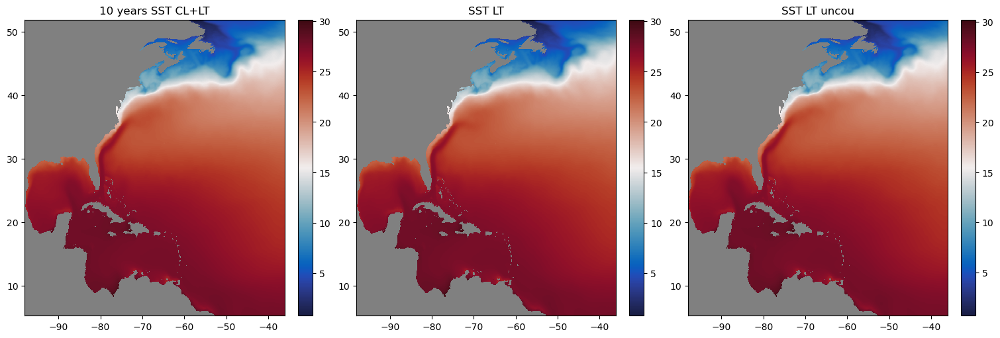

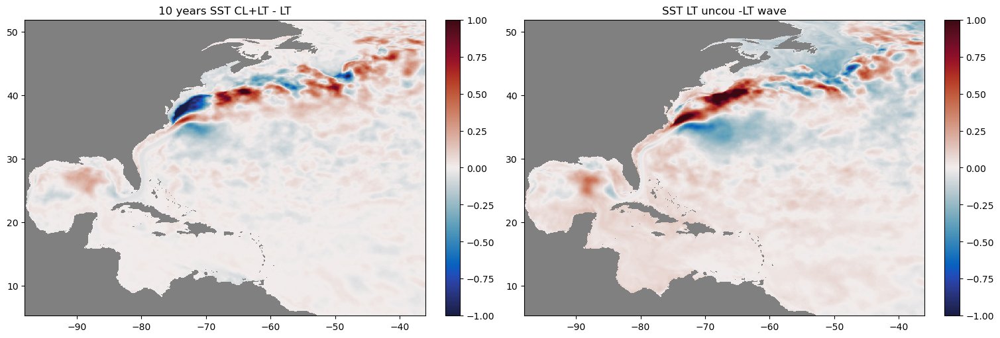

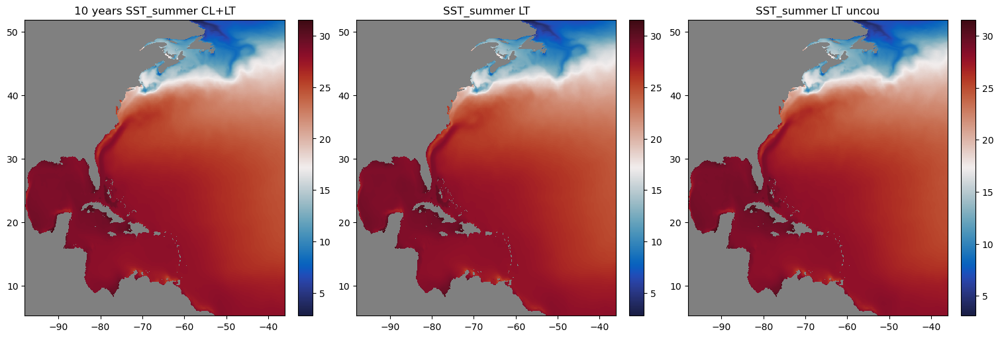

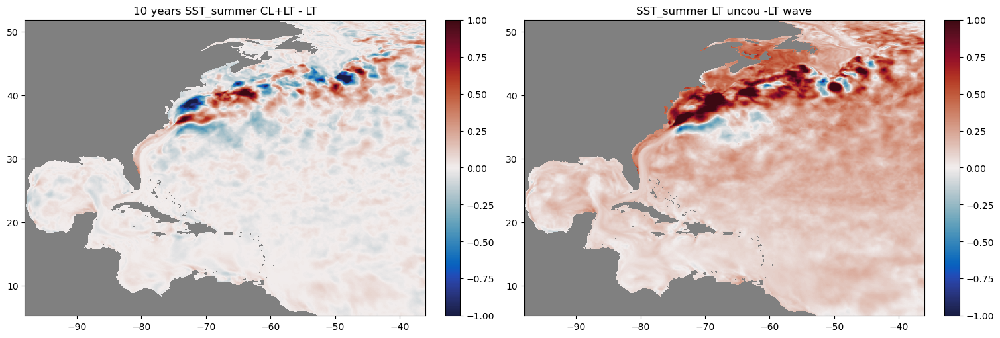

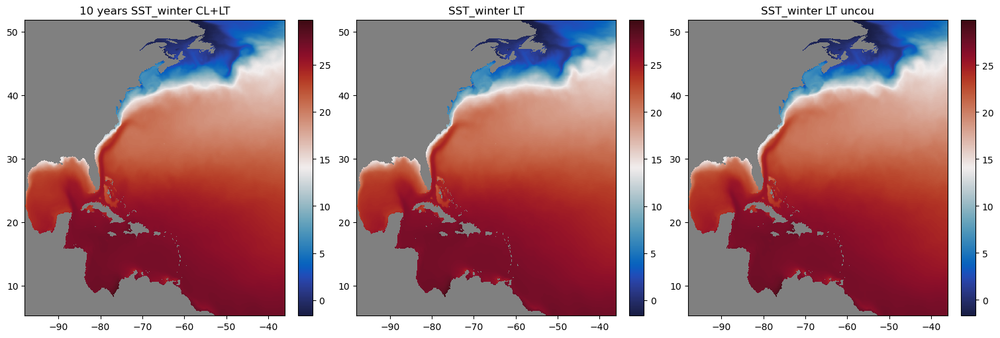

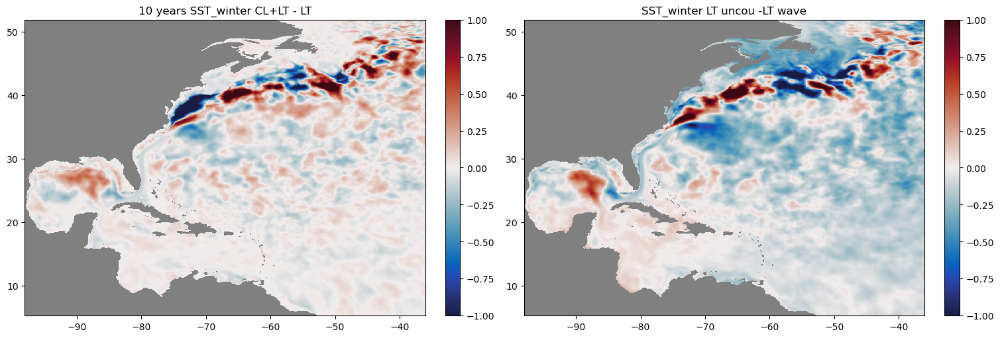

In [7]:
# Example usage


SST_uncou_ave= Dcombined_data_uncou['SST'].mean(dim='time')
SST_summer_uncou_ave= Dsummer_data_uncou['SST'].mean(dim='time')
SST_winter_uncou_ave= Dwinter_data_uncou['SST'].mean(dim='time')

SST_6_all_ave= Dcombined_data_6_all['SST'].mean(dim='time')
SST_summer_6_all_ave= Dsummer_data_6_all['SST'].mean(dim='time')
SST_winter_6_all_ave= Dwinter_data_6_all['SST'].mean(dim='time')

SST_6_wave_ave= Dcombined_data_6_wave['SST'].mean(dim='time')
SST_summer_6_wave_ave= Dsummer_data_6_wave['SST'].mean(dim='time')
SST_winter_6_wave_ave= Dwinter_data_6_wave['SST'].mean(dim='time')

diff_SST_uncou_ave=SST_uncou_ave-SST_6_wave_ave
diff_SST_all_ave=SST_6_all_ave-SST_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years SST CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years SST CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_SST_summer_uncou_ave=SST_summer_uncou_ave-SST_summer_6_wave_ave
diff_SST_summer_all_ave=SST_summer_6_all_ave-SST_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years SST_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years SST_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_SST_winter_uncou_ave=SST_winter_uncou_ave-SST_winter_6_wave_ave
diff_SST_winter_all_ave=SST_winter_6_all_ave-SST_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years SST_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years SST_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('SST_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

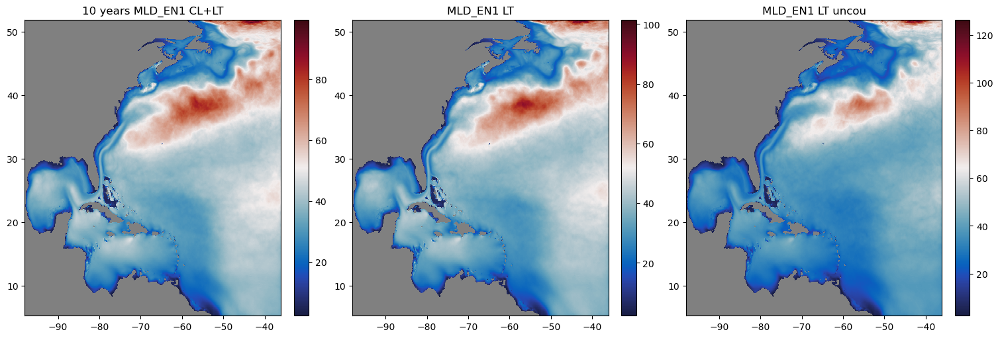

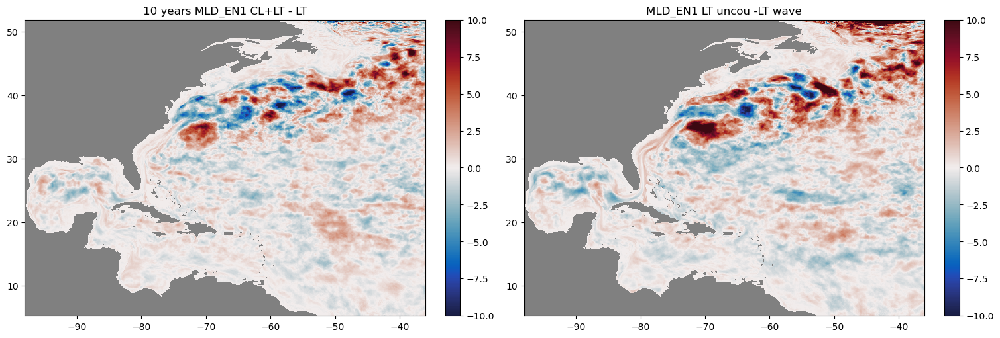

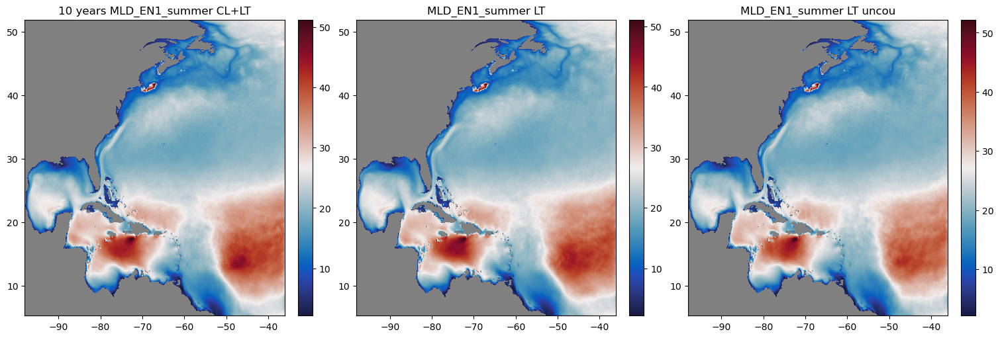

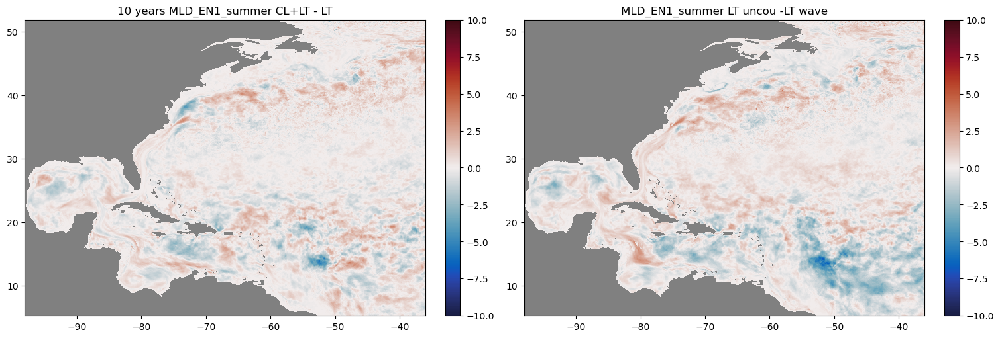

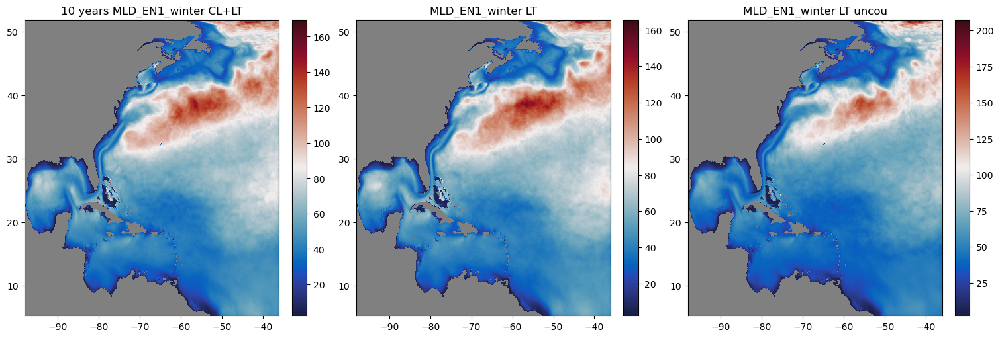

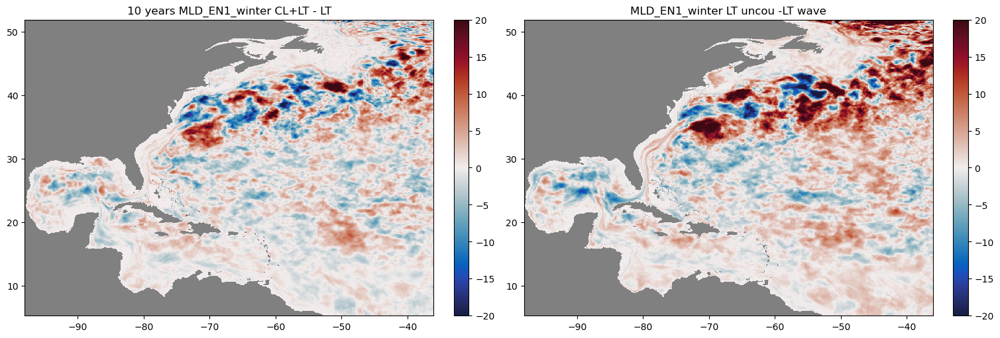

In [11]:
MLD_EN1_uncou_ave= Mcombined_data_uncou['MLD_EN1'].mean(dim='time')
MLD_EN1_summer_uncou_ave= Msummer_data_uncou['MLD_EN1'].mean(dim='time')
MLD_EN1_winter_uncou_ave= Mwinter_data_uncou['MLD_EN1'].mean(dim='time')

MLD_EN1_6_all_ave= combined_data_6_all['MLD_EN1'].mean(dim='time')
MLD_EN1_summer_6_all_ave= summer_data_6_all['MLD_EN1'].mean(dim='time')
MLD_EN1_winter_6_all_ave= winter_data_6_all['MLD_EN1'].mean(dim='time')

MLD_EN1_6_wave_ave= combined_data_6_wave['MLD_EN1'].mean(dim='time')
MLD_EN1_summer_6_wave_ave= summer_data_6_wave['MLD_EN1'].mean(dim='time')
MLD_EN1_winter_6_wave_ave= winter_data_6_wave['MLD_EN1'].mean(dim='time')

diff_MLD_EN1_uncou_ave=MLD_EN1_uncou_ave-MLD_EN1_6_wave_ave
diff_MLD_EN1_all_ave=MLD_EN1_6_all_ave-MLD_EN1_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years MLD_EN1 CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1 LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_all_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('10 years MLD_EN1 CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_ave, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[1].set_title('MLD_EN1 LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_MLD_EN1_summer_uncou_ave=MLD_EN1_summer_uncou_ave-MLD_EN1_summer_6_wave_ave
diff_MLD_EN1_summer_all_ave=MLD_EN1_summer_6_all_ave-MLD_EN1_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years MLD_EN1_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_all_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('10 years MLD_EN1_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[1].set_title('MLD_EN1_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_MLD_EN1_winter_uncou_ave=MLD_EN1_winter_uncou_ave-MLD_EN1_winter_6_wave_ave
diff_MLD_EN1_winter_all_ave=MLD_EN1_winter_6_all_ave-MLD_EN1_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years MLD_EN1_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_all_ave , cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[0].set_title('10 years MLD_EN1_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[1].set_title('MLD_EN1_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

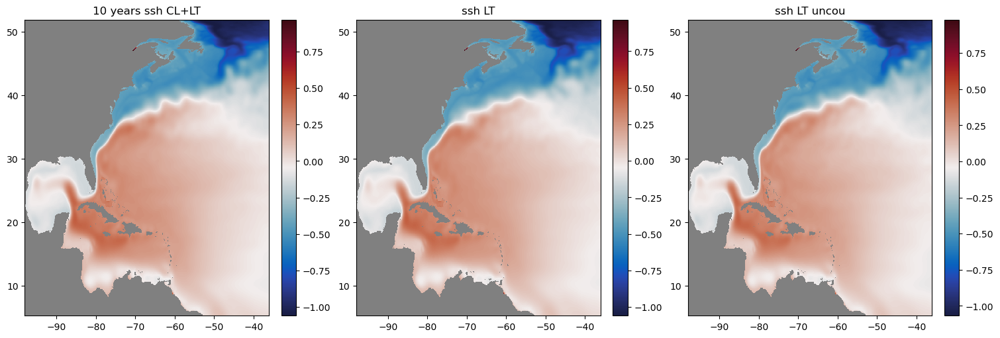

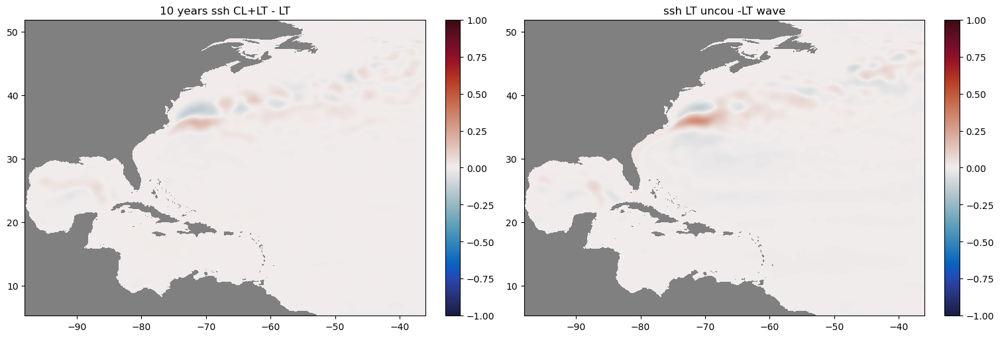

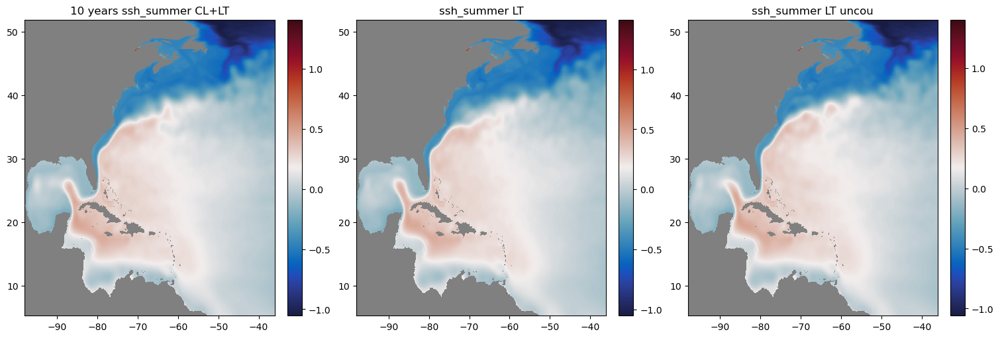

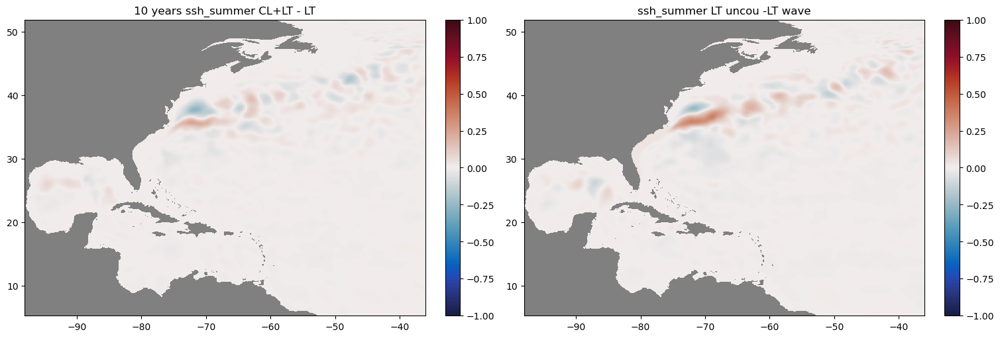

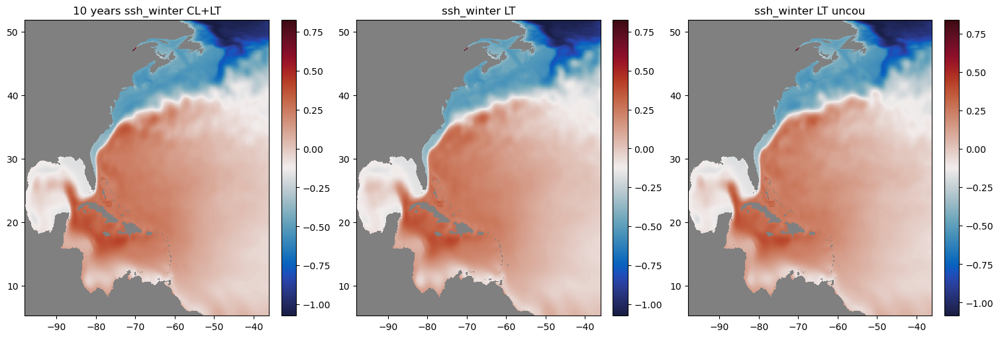

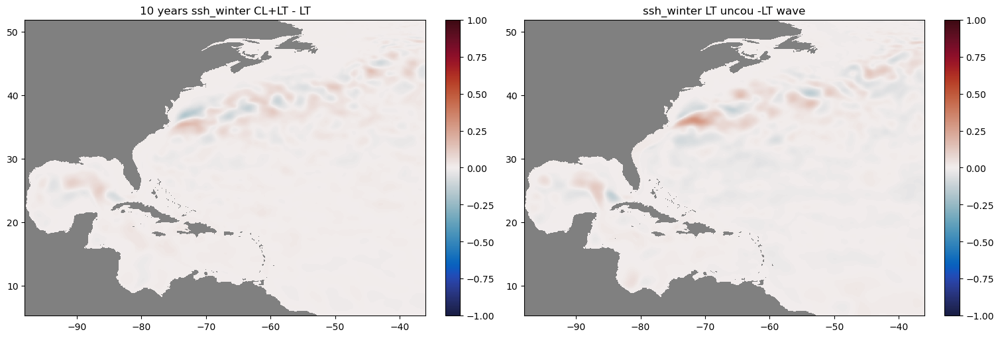

In [12]:
ssh_uncou_ave= Mcombined_data_uncou['ssh'].mean(dim='time')
ssh_summer_uncou_ave= Msummer_data_uncou['ssh'].mean(dim='time')
ssh_winter_uncou_ave= Mwinter_data_uncou['ssh'].mean(dim='time')

ssh_6_all_ave= combined_data_6_all['ssh'].mean(dim='time')
ssh_summer_6_all_ave= summer_data_6_all['ssh'].mean(dim='time')
ssh_winter_6_all_ave= winter_data_6_all['ssh'].mean(dim='time')

ssh_6_wave_ave= combined_data_6_wave['ssh'].mean(dim='time')
ssh_summer_6_wave_ave= summer_data_6_wave['ssh'].mean(dim='time')
ssh_winter_6_wave_ave= winter_data_6_wave['ssh'].mean(dim='time')

diff_ssh_uncou_ave=ssh_uncou_ave-ssh_6_wave_ave
diff_ssh_all_ave=ssh_6_all_ave-ssh_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years ssh CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('ssh LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years ssh CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('ssh LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_ssh_summer_uncou_ave=ssh_summer_uncou_ave-ssh_summer_6_wave_ave
diff_ssh_summer_all_ave=ssh_summer_6_all_ave-ssh_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years ssh_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('ssh_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years ssh_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('ssh_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_ssh_winter_uncou_ave=ssh_winter_uncou_ave-ssh_winter_6_wave_ave
diff_ssh_winter_all_ave=ssh_winter_6_all_ave-ssh_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssh_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years ssh_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('ssh_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years ssh_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('ssh_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

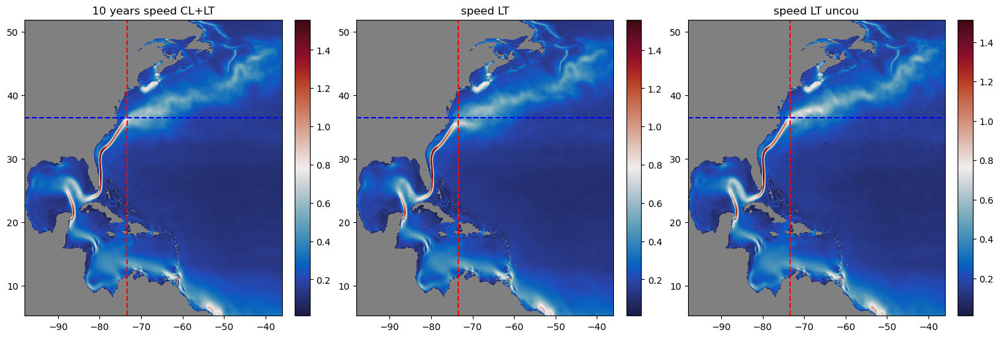

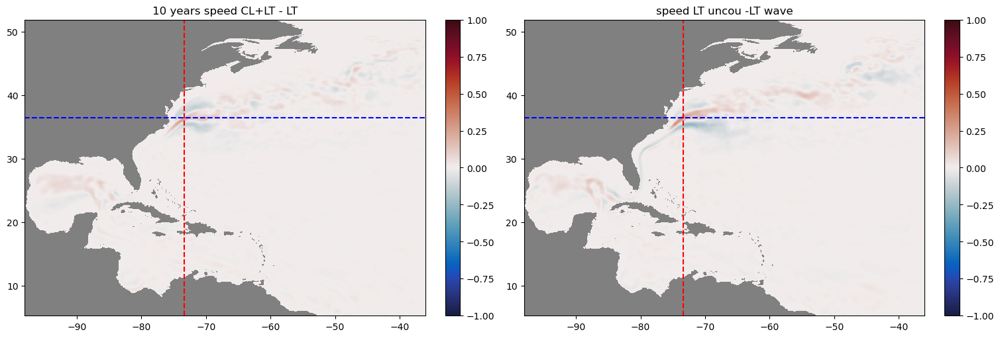

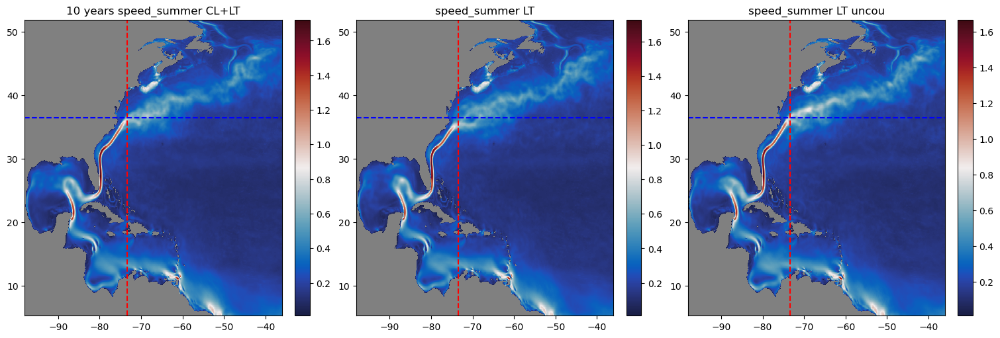

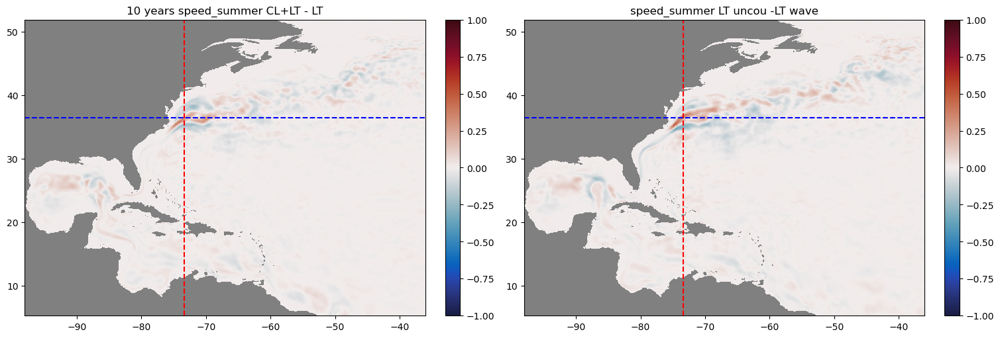

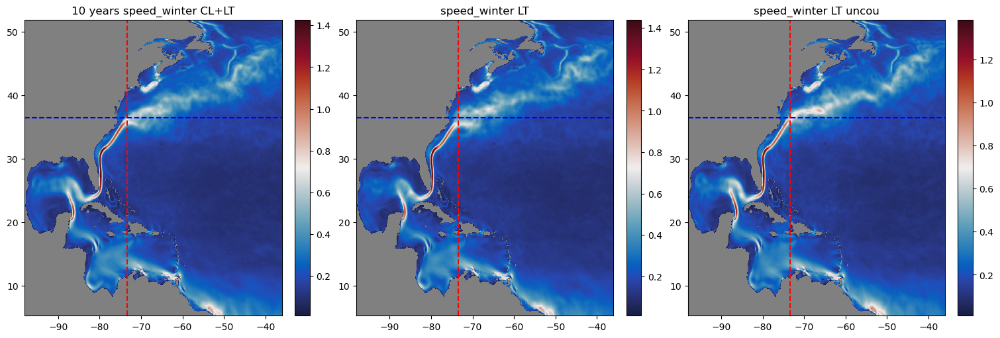

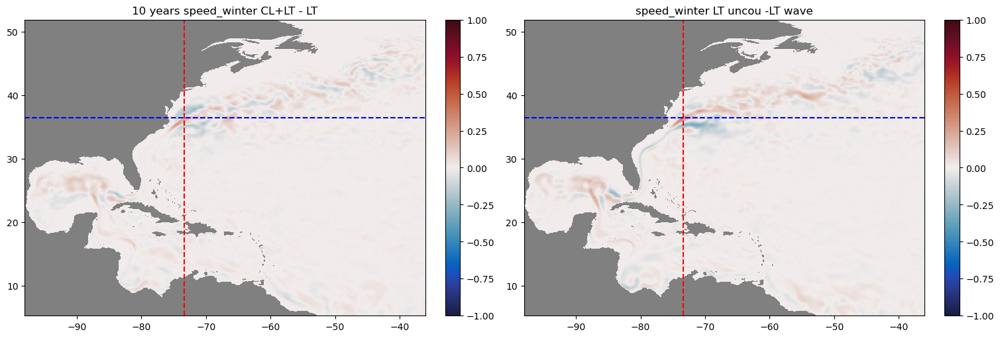

In [19]:
speed_uncou= Mcombined_data_uncou['speed']
speed_summer_uncou= Msummer_data_uncou['speed']
speed_winter_uncou= Mwinter_data_uncou['speed']
speed_uncou_ave=speed_uncou.mean('time')
speed_summer_uncou_ave=speed_summer_uncou.mean('time')
speed_winter_uncou_ave=speed_winter_uncou.mean('time')

speed_6_all= combined_data_6_all['speed']
speed_summer_6_all= summer_data_6_all['speed']
speed_winter_6_all= winter_data_6_all['speed']
speed_6_all_ave=speed_6_all.mean('time')
speed_summer_6_all_ave=speed_summer_6_all.mean('time')
speed_winter_6_all_ave=speed_winter_6_all.mean('time')

speed_6_wave= combined_data_6_wave['speed']
speed_summer_6_wave= summer_data_6_wave['speed']
speed_winter_6_wave= winter_data_6_wave['speed']
speed_6_wave_ave=speed_6_wave.mean('time')
speed_summer_6_wave_ave=speed_summer_6_wave.mean('time')
speed_winter_6_wave_ave=speed_winter_6_wave.mean('time')


diff_speed_uncou_ave=speed_uncou_ave-speed_6_wave_ave
diff_speed_all_ave=speed_6_all_ave-speed_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years speed CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years speed CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('speed LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')


plt.show()


diff_speed_summer_uncou_ave=speed_summer_uncou_ave-speed_summer_6_wave_ave
diff_speed_summer_all_ave=speed_summer_6_all_ave-speed_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years speed_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years speed_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('speed_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

diff_speed_winter_uncou_ave=speed_winter_uncou_ave-speed_winter_6_wave_ave
diff_speed_winter_all_ave=speed_winter_6_all_ave-speed_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years speed_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years speed_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('speed_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

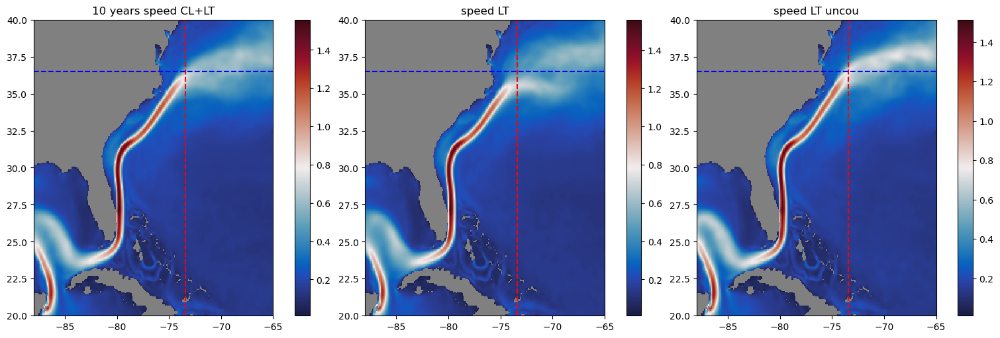

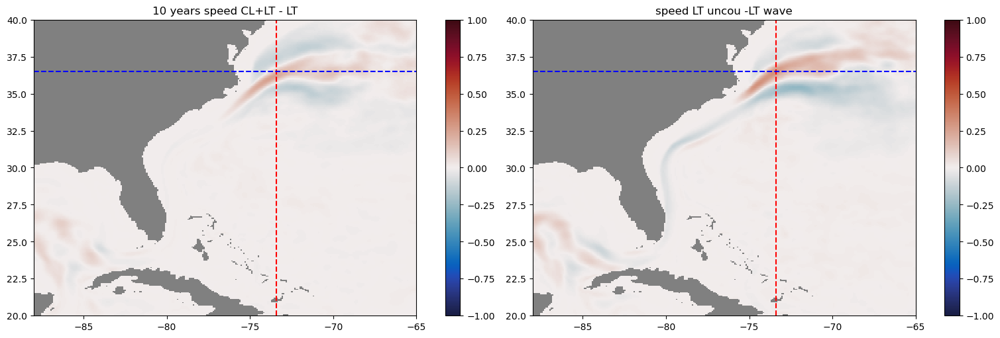

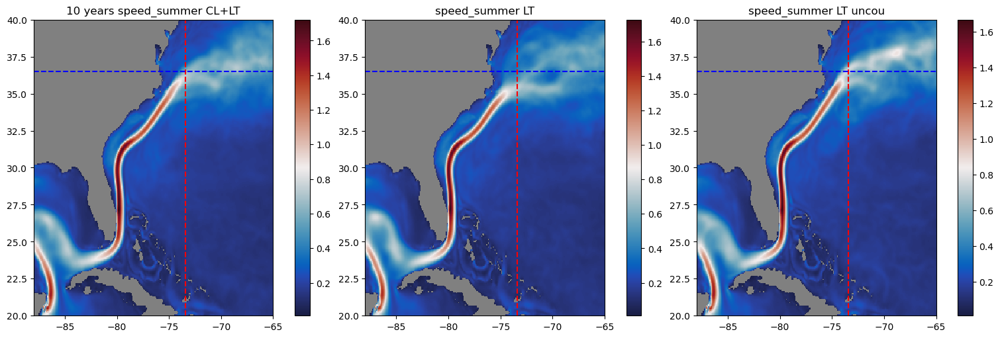

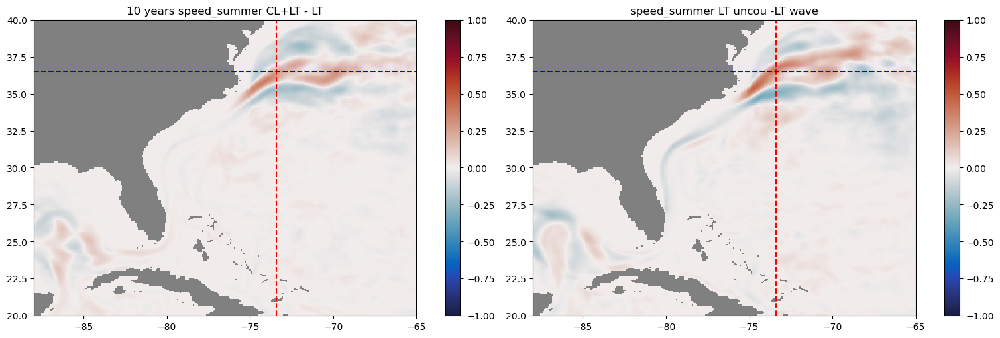

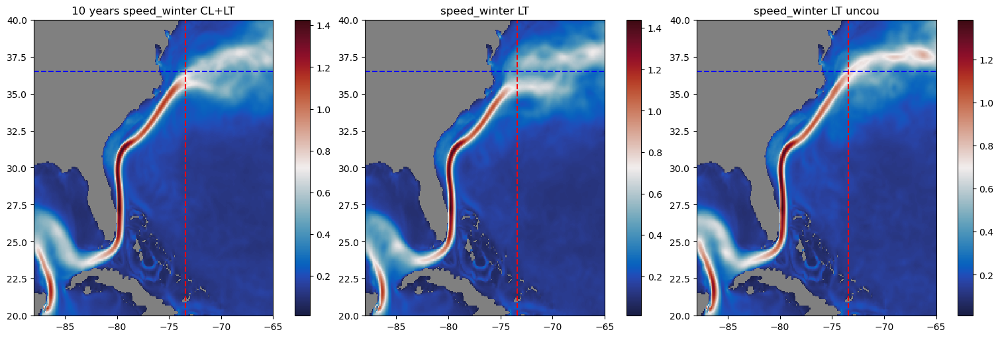

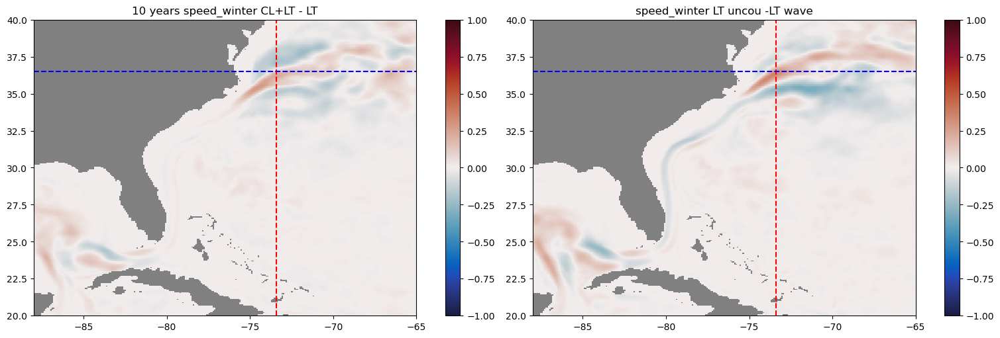

In [18]:
diff_speed_uncou_ave=speed_uncou_ave-speed_6_wave_ave
diff_speed_all_ave=speed_6_all_ave-speed_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years speed CL+LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed LT')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years speed CL+LT - LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('speed LT uncou -LT wave')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()


diff_speed_summer_uncou_ave=speed_summer_uncou_ave-speed_summer_6_wave_ave
diff_speed_summer_all_ave=speed_summer_6_all_ave-speed_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years speed_summer CL+LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_summer LT')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_summer_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_summer LT uncou')
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years speed_summer CL+LT - LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_summer_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('speed_summer LT uncou -LT wave')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

diff_speed_winter_uncou_ave=speed_winter_uncou_ave-speed_winter_6_wave_ave
diff_speed_winter_all_ave=speed_winter_6_all_ave-speed_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years speed_winter CL+LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, speed_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('speed_winter LT')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, speed_winter_uncou_ave, cmap=cmap, shading='auto')
axes[2].set_title('speed_winter LT uncou')
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

axes[2].axvline(x=-73.4, color='red', linestyle='--')
axes[2].axhline(y=36.5, color='blue', linestyle='--')
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_all_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('10 years speed_winter CL+LT - LT')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_speed_winter_uncou_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[1].set_title('speed_winter LT uncou -LT wave')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
axes[0].axvline(x=-73.4, color='red', linestyle='--')  # Vertical line
axes[0].axhline(y=36.5, color='blue', linestyle='--')  # Horizontal line

axes[1].axvline(x=-73.4, color='red', linestyle='--')
axes[1].axhline(y=36.5, color='blue', linestyle='--')

plt.show()

In [13]:
def calculate_ssh_gradient_nonuniform(SSH, xh, yh):
    grad_x = np.zeros_like(SSH)
    grad_y = np.zeros_like(SSH)
    
    # Loop over the interior points only to avoid boundary issues
    for j in range(1, len(yh) - 1):  # Loop over 'yh' (rows, y-direction)
        for i in range(1, len(xh) - 1):  # Loop over 'xh' (columns, x-direction)
            dx = xh[i+1] - xh[i-1]  # Local dx for point (j, i)
            dy = yh[j+1] - yh[j-1]  # Local dy for point (j, i)

            grad_x[j, i] = (SSH[j, i+1] - SSH[j, i-1]) / dx  # Gradient in x-direction
            grad_y[j, i] = (SSH[j+1, i] - SSH[j-1, i]) / dy  # Gradient in y-direction
    
    # Optionally, compute the gradient magnitude

    
    return grad_x, grad_y

gx_summer_uncou,gy_summer_uncou=calculate_ssh_gradient_nonuniform(ssh_summer_uncou_ave, model_grid_x, model_grid_y)
gx_winter_uncou,gy_winter_uncou=calculate_ssh_gradient_nonuniform(ssh_winter_uncou_ave, model_grid_x, model_grid_y)
gx_uncou,gy_uncou=calculate_ssh_gradient_nonuniform(ssh_uncou_ave, model_grid_x, model_grid_y)

gx_summer_6_all,gy_summer_6_all=calculate_ssh_gradient_nonuniform(ssh_summer_6_all_ave, model_grid_x, model_grid_y)
gx_winter_6_all,gy_winter_6_all=calculate_ssh_gradient_nonuniform(ssh_winter_6_all_ave, model_grid_x, model_grid_y)
gx_6_all,gy_6_all=calculate_ssh_gradient_nonuniform(ssh_6_all_ave, model_grid_x, model_grid_y)

gx_summer_6_wave,gy_summer_6_wave=calculate_ssh_gradient_nonuniform(ssh_summer_6_wave_ave, model_grid_x, model_grid_y)
gx_winter_6_wave,gy_winter_6_wave=calculate_ssh_gradient_nonuniform(ssh_winter_6_wave_ave, model_grid_x, model_grid_y)
gx_6_wave,gy_6_wave=calculate_ssh_gradient_nonuniform(ssh_6_wave_ave, model_grid_x, model_grid_y)

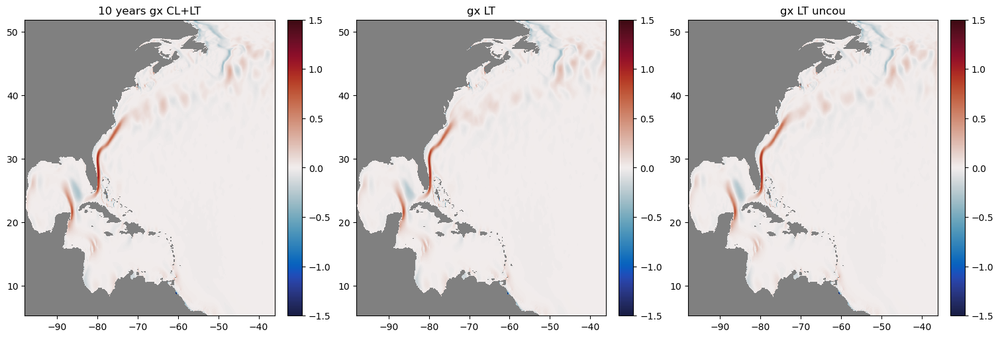

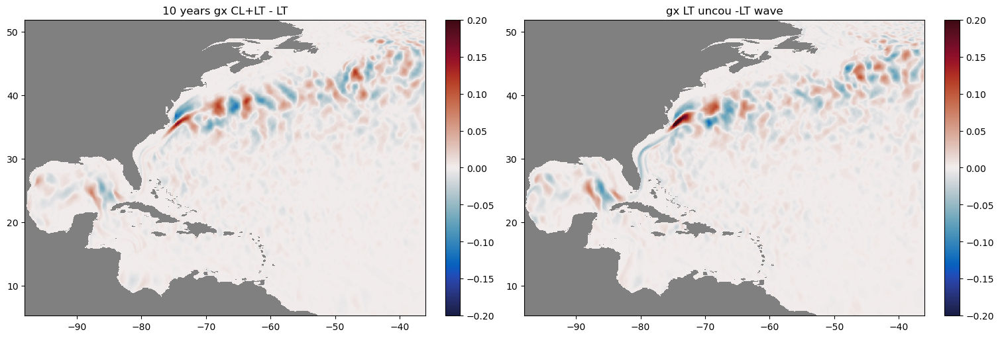

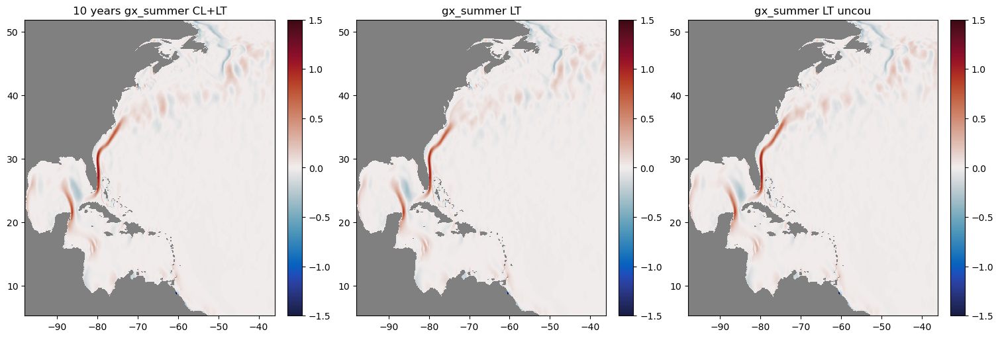

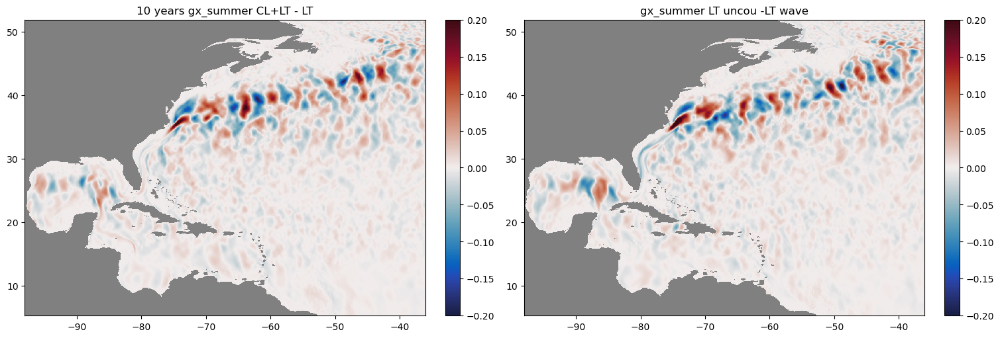

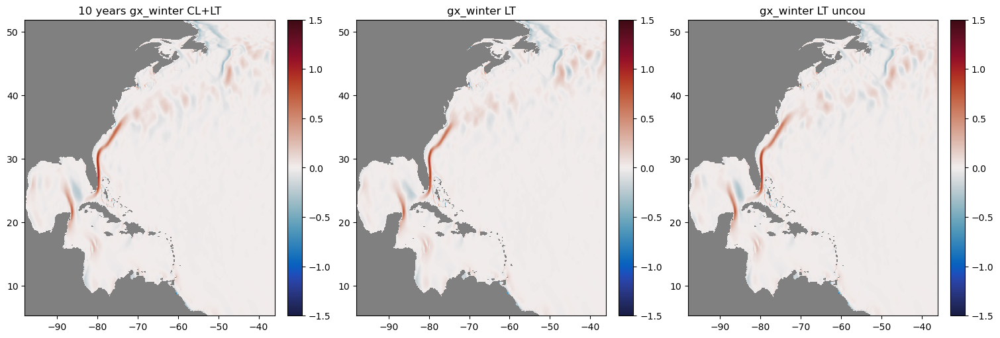

...

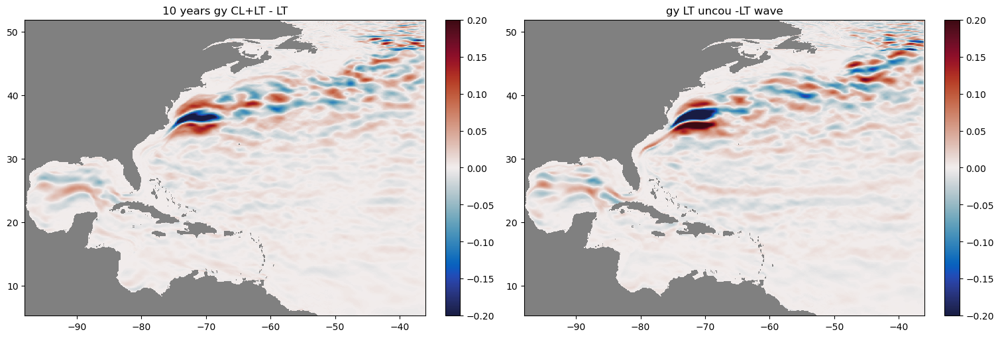

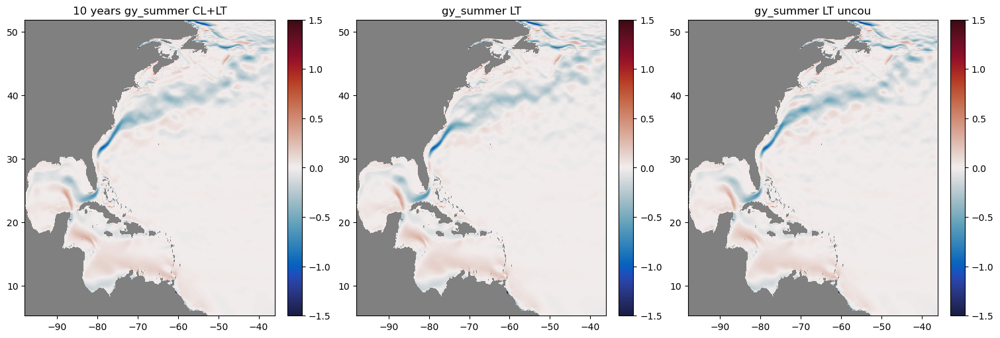

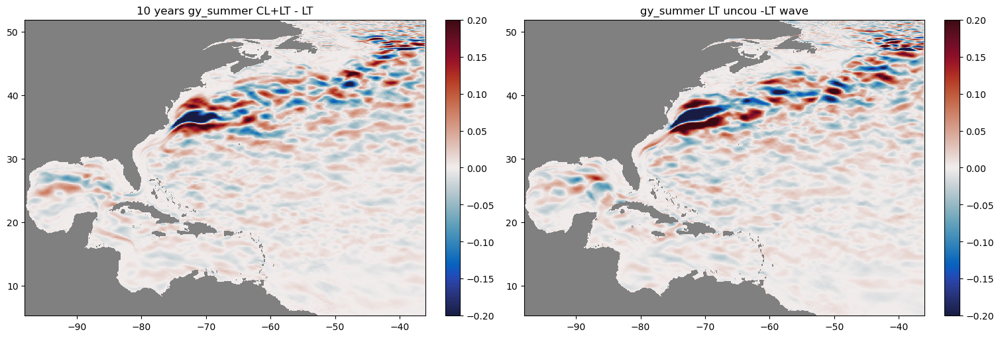

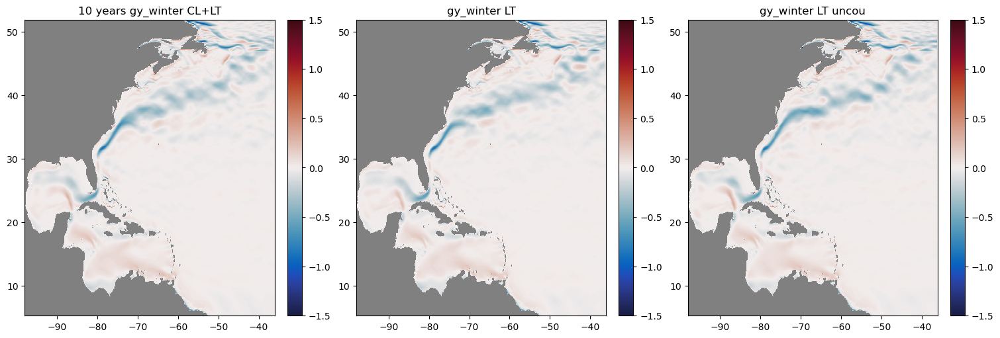

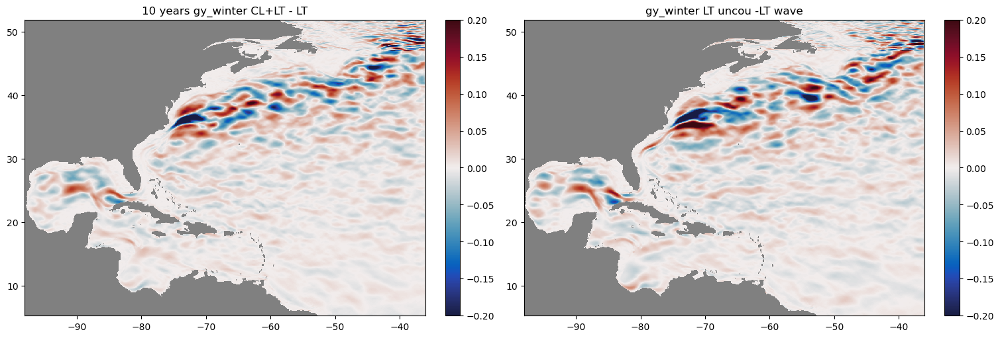

In [16]:
diff_gx_uncou=gx_uncou-gx_6_wave
diff_gx_all=gx_6_all-gx_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gx_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('10 years gx CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gx LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gx LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gx_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('10 years gx CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gx_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gx LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gx_summer_uncou=gx_summer_uncou-gx_summer_6_wave
diff_gx_summer_all=gx_summer_6_all-gx_summer_6_wave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gx_summer_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('10 years gx_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_summer_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gx_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_summer_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gx_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gx_summer_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('10 years gx_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gx_summer_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gx_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gx_winter_uncou=gx_winter_uncou-gx_winter_6_wave
diff_gx_winter_all=gx_winter_6_all-gx_winter_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gx_winter_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('10 years gx_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_winter_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gx_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_winter_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gx_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gx_winter_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('10 years gx_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gx_winter_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gx_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()


diff_gy_uncou=gy_uncou-gy_6_wave
diff_gy_all=gy_6_all-gy_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gy_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('10 years gy CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gy LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gy LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gy_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('10 years gy CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gy_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gy LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gy_summer_uncou=gy_summer_uncou-gy_summer_6_wave
diff_gy_summer_all=gy_summer_6_all-gy_summer_6_wave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gy_summer_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('10 years gy_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_summer_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gy_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_summer_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gy_summer LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gy_summer_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('10 years gy_summer CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gy_summer_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gy_summer LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

diff_gy_winter_uncou=gy_winter_uncou-gy_winter_6_wave
diff_gy_winter_all=gy_winter_6_all-gy_winter_6_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, gy_winter_6_all , cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[0].set_title('10 years gy_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_winter_6_wave, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[1].set_title('gy_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_winter_uncou, cmap=cmap, shading='auto',vmin=-1.5,vmax=1.5)
axes[2].set_title('gy_winter LT uncou')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 2, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_gy_winter_all , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('10 years gy_winter CL+LT - LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_gy_winter_uncou, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('gy_winter LT uncou -LT wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
plt.show()

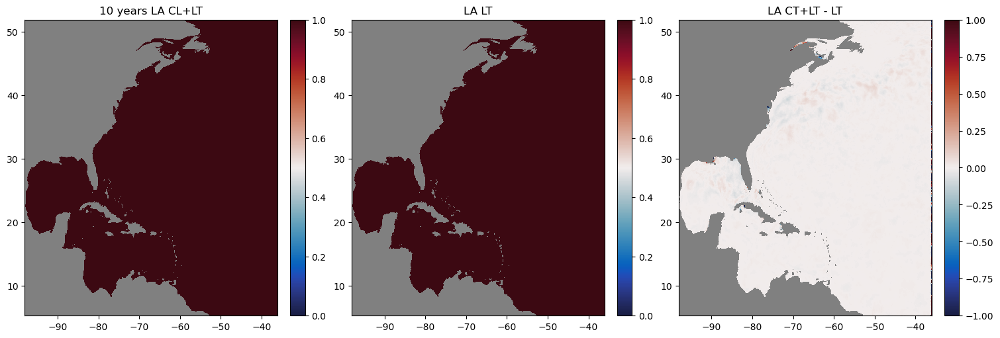

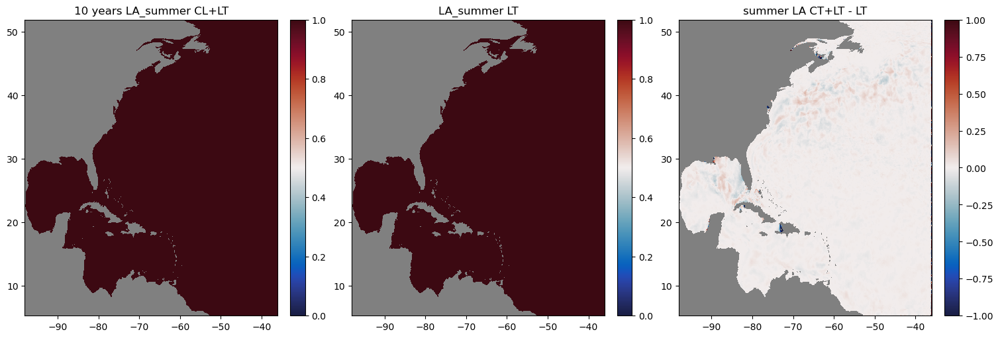

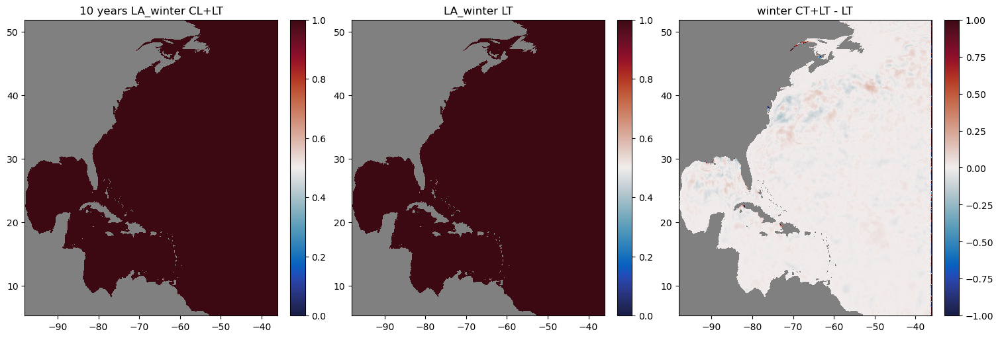

In [22]:

LA_6_all_ave= combined_data_6_all['LA'].mean(dim='time')
LA_summer_6_all_ave= summer_data_6_all['LA'].mean(dim='time')
LA_winter_6_all_ave= winter_data_6_all['LA'].mean(dim='time')

LA_6_wave_ave= combined_data_6_wave['LA'].mean(dim='time')
LA_summer_6_wave_ave= summer_data_6_wave['LA'].mean(dim='time')
LA_winter_6_wave_ave= winter_data_6_wave['LA'].mean(dim='time')


diff_LA_all_ave=LA_6_all_ave-LA_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('10 years LA CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('LA CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_LA_summer_all_ave=LA_summer_6_all_ave-LA_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('10 years LA_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer LA CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_LA_winter_all_ave=LA_winter_6_all_ave-LA_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('10 years LA_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

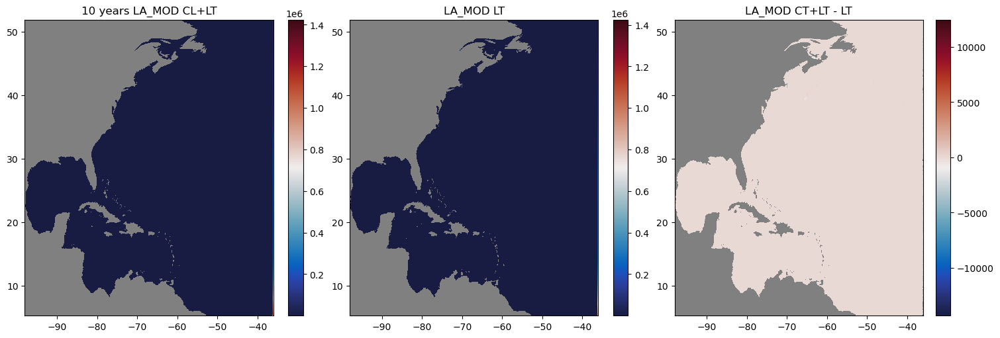

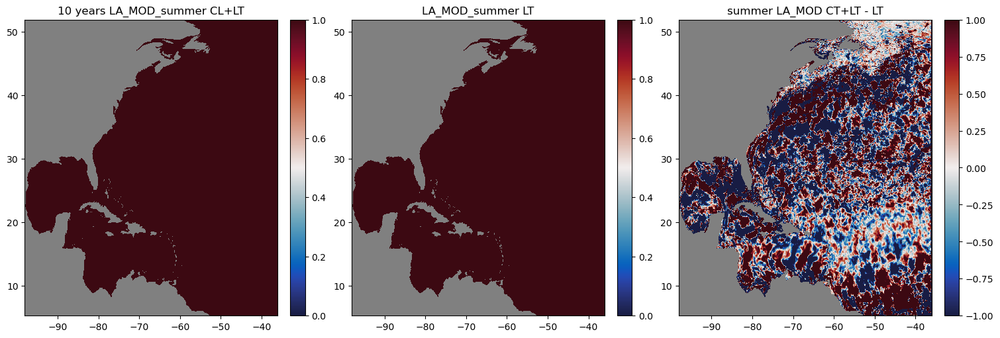

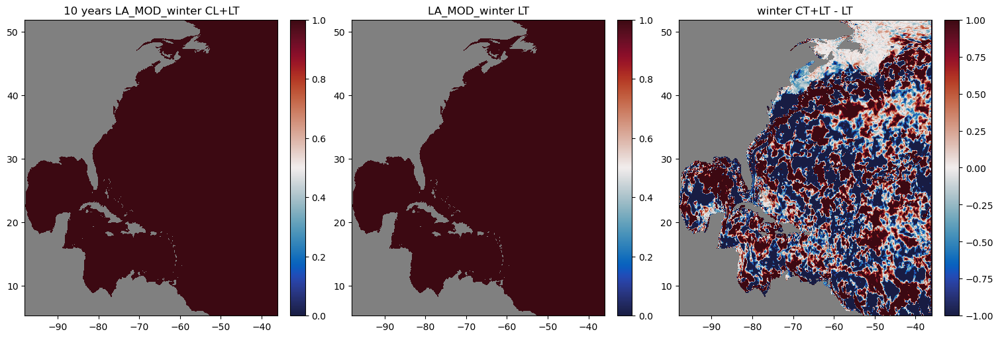

In [25]:
LA_MOD_6_all_ave= combined_data_6_all['LA_MOD'].mean(dim='time')
LA_MOD_summer_6_all_ave= summer_data_6_all['LA_MOD'].mean(dim='time')
LA_MOD_winter_6_all_ave= winter_data_6_all['LA_MOD'].mean(dim='time')

LA_MOD_6_wave_ave= combined_data_6_wave['LA_MOD'].mean(dim='time')
LA_MOD_summer_6_wave_ave= summer_data_6_wave['LA_MOD'].mean(dim='time')
LA_MOD_winter_6_wave_ave= winter_data_6_wave['LA_MOD'].mean(dim='time')


diff_LA_MOD_all_ave=LA_MOD_6_all_ave-LA_MOD_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_MOD_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years LA_MOD CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_MOD_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('LA_MOD LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_MOD_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('LA_MOD CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_LA_MOD_summer_all_ave=LA_MOD_summer_6_all_ave-LA_MOD_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_MOD_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('10 years LA_MOD_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_MOD_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_MOD_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_MOD_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer LA_MOD CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_LA_MOD_winter_all_ave=LA_MOD_winter_6_all_ave-LA_MOD_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, LA_MOD_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('10 years LA_MOD_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, LA_MOD_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('LA_MOD_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_LA_MOD_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

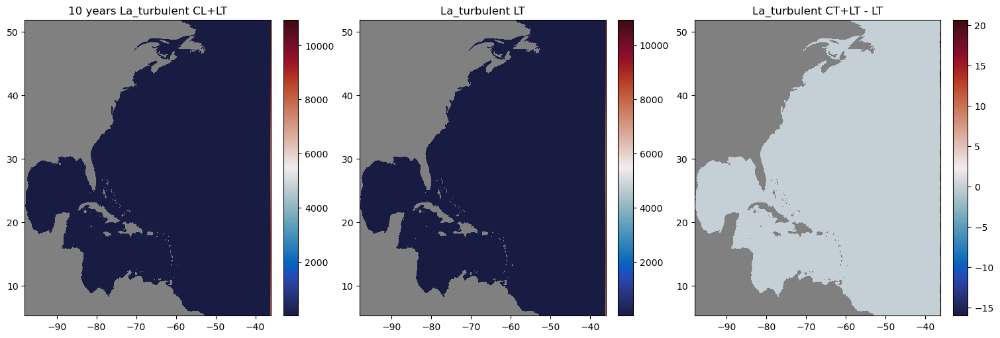

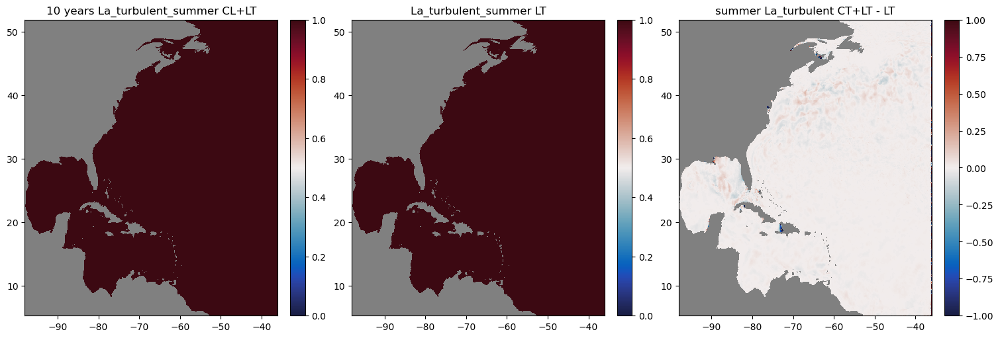

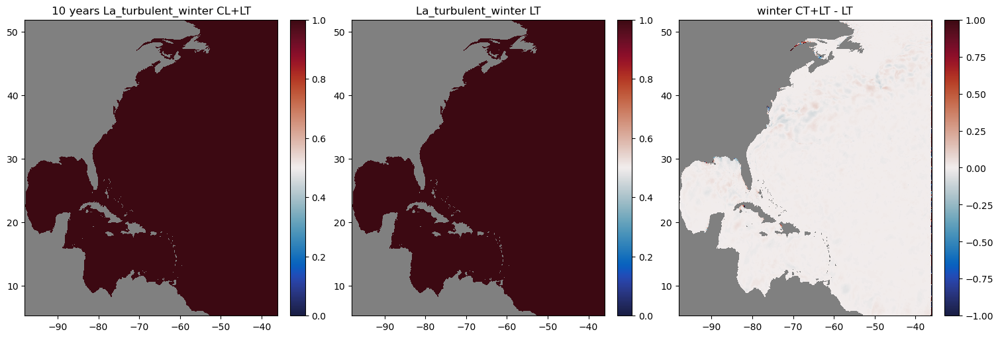

In [26]:
La_turbulent_6_all_ave= combined_data_6_all['La_turbulent'].mean(dim='time')
La_turbulent_summer_6_all_ave= summer_data_6_all['La_turbulent'].mean(dim='time')
La_turbulent_winter_6_all_ave= winter_data_6_all['La_turbulent'].mean(dim='time')

La_turbulent_6_wave_ave= combined_data_6_wave['La_turbulent'].mean(dim='time')
La_turbulent_summer_6_wave_ave= summer_data_6_wave['La_turbulent'].mean(dim='time')
La_turbulent_winter_6_wave_ave= winter_data_6_wave['La_turbulent'].mean(dim='time')


diff_La_turbulent_all_ave=La_turbulent_6_all_ave-La_turbulent_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, La_turbulent_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years La_turbulent CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, La_turbulent_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('La_turbulent LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_La_turbulent_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('La_turbulent CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_La_turbulent_summer_all_ave=La_turbulent_summer_6_all_ave-La_turbulent_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, La_turbulent_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('10 years La_turbulent_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, La_turbulent_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('La_turbulent_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_La_turbulent_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer La_turbulent CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_La_turbulent_winter_all_ave=La_turbulent_winter_6_all_ave-La_turbulent_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, La_turbulent_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[0].set_title('10 years La_turbulent_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, La_turbulent_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=1)
axes[1].set_title('La_turbulent_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_La_turbulent_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

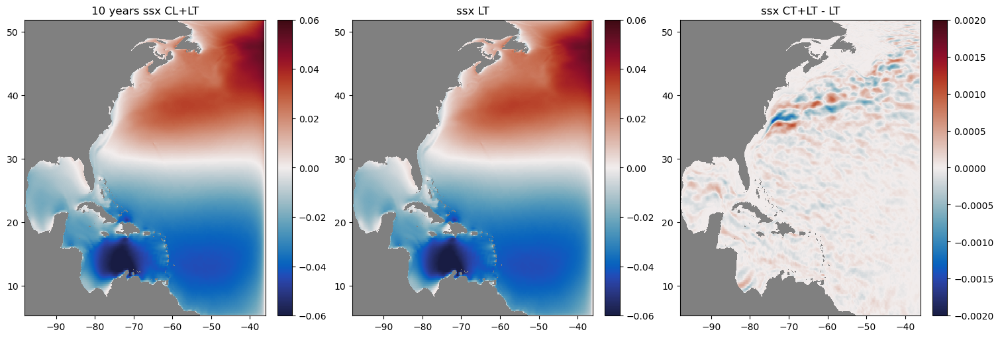

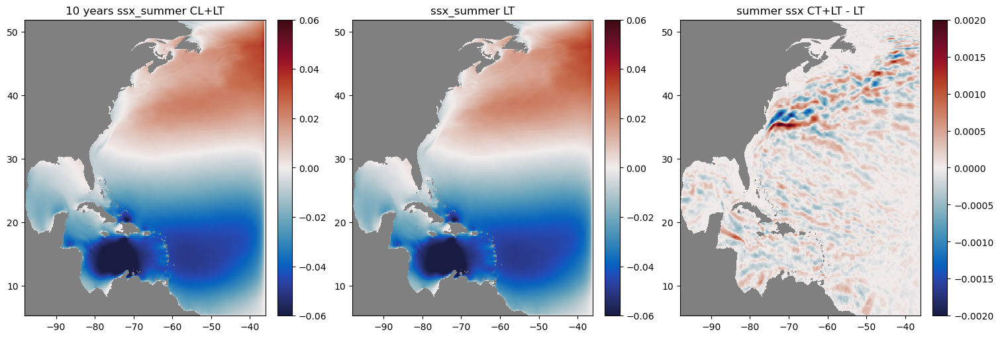

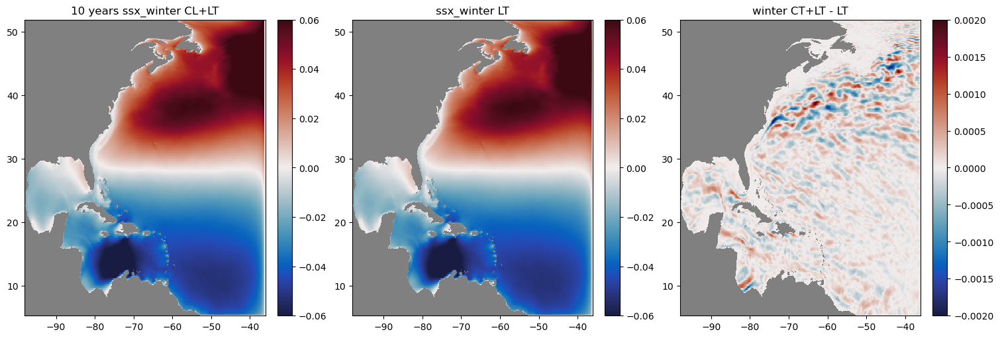

In [29]:
ssx_6_all_ave= combined_data_6_all['surface_stokes_x'].mean(dim='time')[:,1:]
ssx_summer_6_all_ave= summer_data_6_all['surface_stokes_x'].mean(dim='time')[:,1:]
ssx_winter_6_all_ave= winter_data_6_all['surface_stokes_x'].mean(dim='time')[:,1:]

ssx_6_wave_ave= combined_data_6_wave['surface_stokes_x'].mean(dim='time')[:,1:]
ssx_summer_6_wave_ave= summer_data_6_wave['surface_stokes_x'].mean(dim='time')[:,1:]
ssx_winter_6_wave_ave= winter_data_6_wave['surface_stokes_x'].mean(dim='time')[:,1:]
diff_ssx_all_ave=ssx_6_all_ave-ssx_6_wave_ave



fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssx_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('10 years ssx CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssx_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssx LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssx_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('ssx CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_ssx_summer_all_ave=ssx_summer_6_all_ave-ssx_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssx_summer_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('10 years ssx_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssx_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssx_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssx_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('summer ssx CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_ssx_winter_all_ave=ssx_winter_6_all_ave-ssx_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssx_winter_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('10 years ssx_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssx_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssx_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssx_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

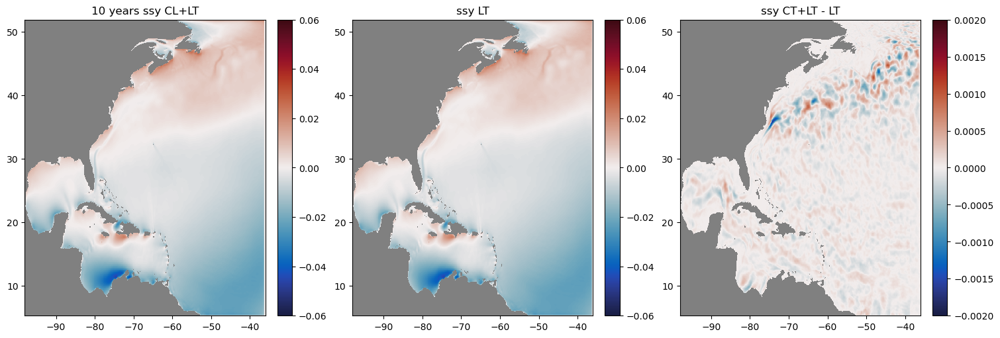

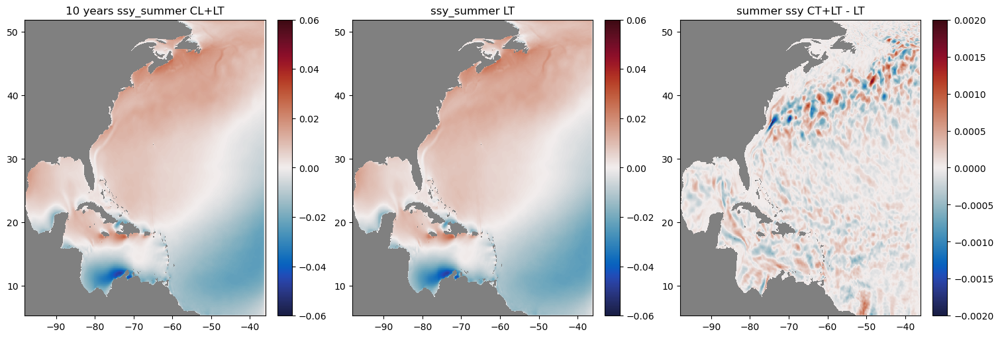

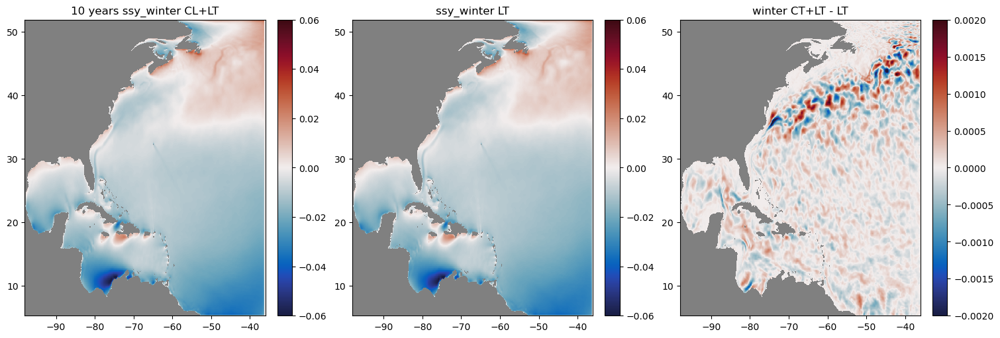

In [31]:
ssy_6_all_ave= combined_data_6_all['surface_stokes_y'].mean(dim='time')[1:,:]
ssy_summer_6_all_ave= summer_data_6_all['surface_stokes_y'].mean(dim='time')[1:,:]
ssy_winter_6_all_ave= winter_data_6_all['surface_stokes_y'].mean(dim='time')[1:,:]

ssy_6_wave_ave= combined_data_6_wave['surface_stokes_y'].mean(dim='time')[1:,:]
ssy_summer_6_wave_ave= summer_data_6_wave['surface_stokes_y'].mean(dim='time')[1:,:]
ssy_winter_6_wave_ave= winter_data_6_wave['surface_stokes_y'].mean(dim='time')[1:,:]
diff_ssy_all_ave=ssy_6_all_ave-ssy_6_wave_ave



fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssy_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('10 years ssy CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssy_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssy LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssy_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('ssy CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()




diff_ssy_summer_all_ave=ssy_summer_6_all_ave-ssy_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssy_summer_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('10 years ssy_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssy_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssy_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssy_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('summer ssy CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_ssy_winter_all_ave=ssy_winter_6_all_ave-ssy_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ssy_winter_6_all_ave , cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[0].set_title('10 years ssy_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssy_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=-0.06,vmax=0.06)
axes[1].set_title('ssy_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssy_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

In [5]:


print("Summer wave data shape:", summer_wave.shape)
print("Winter wave data shape:", winter_wave.shape)
dates

Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 14, 0, 

array([cftime.DatetimeGregorian(1993, 1, 1, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 2, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 3, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 4, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 5, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 6, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 7, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 8, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 9, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 10, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 11, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 12, 0, 0, 0, 0, has_year_zero=False),
       cftime.DatetimeGregorian(1993, 1, 13, 0, 0, 0, 0, has_

In [14]:
import numpy as np
import logging
from netCDF4 import Dataset, num2date
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import logging
import cmocean
import copy
from datetime import datetime, timedelta

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   
###first verage every year and then concate

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"
pp_root_12_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave_all/"
pp_root_12_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_wave/"
pp_root_6_all="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/"
pp_root_6_wave="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/"

def Extend_file_list(file_list):
    transformed_file_list = []
    
    for date in file_list:
        year_month = date[:6]  # Extract YYYYMM
        date_1 = year_month + "01"
        ndate = int(year_month)
        
        # Generate date_2 to date_7 as integer year_month values
        date_2 = str(ndate + 1)
        date_3 = str(ndate + 2)
        date_4 = str(ndate + 3)
        date_5 = str(ndate + 4)
        date_6 = str(ndate + 5)
        date_7 = str(ndate + 6)
    
        # If moving to the 13th month, roll over to next January
        if int(date_7[-2:]) > 12:
            date_7 = str(int(date_7[:4]) + 1) + "01"  # Roll over to next January
        else:
            date_7 = str(ndate + 6)  # Keep it as is if the month doesn't exceed 12
        
        list_date = [date_1, date_2, date_3, date_4, date_5, date_6, date_7]
        
        for date_str in list_date:
            # Create the transformed file string
            transformed_file = f"{date_1}_results/ww3.{date_str}.nc"
            transformed_file_list.append(transformed_file)
    return transformed_file_list

    
def hs_mean_from_files(pp_root, file_list, model_grid_x, model_grid_y):
    data={}
    S_data={}
    W_data={}
    hs_data = []
    cur_data = []
    wnd_data = []
    S_hs_data = []
    S_cur_data = []
    S_wnd_data = []
    W_hs_data = []
    W_cur_data = []
    W_wnd_data = []
    E_file_list=Extend_file_list(file_list)

    for date_str in E_file_list:
        file_path = os.path.join(pp_root, date_str)
        print(file_path)
        if os.path.exists(file_path):
            try:
                ww3 = Dataset(file_path)
                hs = ww3.variables['hs'][:]
                t = ww3.variables['time'][:]
                ucur = ww3.variables['ucur'][:]
                vcur = ww3.variables['vcur'][:]
                uwnd = ww3.variables['uwnd'][:]
                vwnd = ww3.variables['vwnd'][:]

                cur = np.sqrt(ucur**2 + vcur**2)
                wnd = np.sqrt(uwnd**2 + vwnd**2)

                da_hs = xr.DataArray(hs, dims=['time', 'yh', 'xh'], coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y})
                da_cur = xr.DataArray(cur, dims=['time', 'yh', 'xh'], coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y})
                da_wnd = xr.DataArray(wnd, dims=['time', 'yh', 'xh'], coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y})

                hs_data.append(da_hs.mean(dim='time'))
                cur_data.append(da_cur.mean(dim='time'))
                wnd_data.append(da_wnd.mean(dim='time'))
               

                time_units = ww3.variables['time'].units
                time_calendar = getattr(ww3.variables['time'], 'calendar', 'standard')
                dates = num2date(t, units=time_units, calendar=time_calendar)
                dates = np.array(dates)
                summer_indices = np.array([d.month in [6, 7, 8] for d in dates])
                winter_indices = np.array([d.month in [12, 1, 2] for d in dates])
                
                # Extract summer and winter dates
                summer_dates = dates[summer_indices]
                winter_dates = dates[winter_indices]
                # print("Summer dates:", summer_dates)
                # print("Winter dates:", winter_dates)
                if len(summer_dates) > 0:
                    summer_hs = hs[summer_indices]
                    da_summer_hs = xr.DataArray(summer_hs, dims=['time', 'yh', 'xh'], coords={'time':summer_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    S_hs_data.append(da_summer_hs.mean(dim='time'))
                    summer_cur = cur[summer_indices]
                    da_summer_cur = xr.DataArray(summer_cur, dims=['time', 'yh', 'xh'], coords={'time':summer_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    S_cur_data.append(da_summer_cur.mean(dim='time'))
                    summer_wnd = wnd[summer_indices]
                    da_summer_wnd = xr.DataArray(summer_wnd, dims=['time', 'yh', 'xh'], coords={'time':summer_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    S_wnd_data.append(da_summer_wnd.mean(dim='time'))
                if len(winter_dates) > 0:
                    winter_hs = hs[winter_indices]
                    da_winter_hs = xr.DataArray(winter_hs, dims=['time', 'yh', 'xh'], coords={'time':winter_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    W_hs_data.append(da_winter_hs.mean(dim='time'))
                    winter_cur = cur[winter_indices]
                    da_winter_cur = xr.DataArray(winter_cur, dims=['time', 'yh', 'xh'], coords={'time':winter_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    W_cur_data.append(da_winter_cur.mean(dim='time'))
                    winter_wnd = wnd[winter_indices]
                    da_winter_wnd = xr.DataArray(winter_wnd, dims=['time', 'yh', 'xh'], coords={'time':winter_dates , 'xh': model_grid_x, 'yh': model_grid_y})
                    W_wnd_data.append(da_winter_wnd.mean(dim='time'))
                    
               

            except Exception as e:
                print(f"Error processing file {file_path}: {e}")
        else:
            print(f"File not found: {file_path}")

    data['hs'] = xr.concat(hs_data, dim='time').mean(dim='time') if hs_data else None
    data['cur'] = xr.concat(cur_data, dim='time').mean(dim='time') if cur_data else None
    data['wnd'] = xr.concat(wnd_data, dim='time').mean(dim='time') if wnd_data else None
    
    S_data['hs'] = xr.concat(S_hs_data, dim='time').mean(dim='time') if hs_data else None
    S_data['cur'] = xr.concat(S_cur_data, dim='time').mean(dim='time') if cur_data else None
    S_data['wnd'] = xr.concat(S_wnd_data, dim='time').mean(dim='time') if wnd_data else None

    W_data['hs'] = xr.concat(W_hs_data, dim='time').mean(dim='time') if hs_data else None
    W_data['cur'] = xr.concat(W_cur_data, dim='time').mean(dim='time') if cur_data else None
    W_data['wnd'] = xr.concat(W_wnd_data, dim='time').mean(dim='time') if wnd_data else None
    return data, S_data, W_data
    

file_list = [
    "19930101",
    "19930701",
    "19940101",
    "19940701",
    "19950101",
    "19950701",
    "19960101",
    "19960701",
    "19970101",
    "19970701",
    "19980101",
    "19980701",
    "19990101",
    "19990701",
    "20000101",
    "20000701",
    "20010101",
    "20010701",
    "20020101",
    "20020701",
    "20030101",
    "20030701"
]

ww3_1 = Dataset("/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.19930101.nc")
model_grid_x_6=ww3_1.variables['longitude'][0,:]
model_grid_y_6=ww3_1.variables['latitude'][:,0]

data_6_wave,S_data_6_wave, W_data_6_wave=hs_mean_from_files(pp_root_6_wave, file_list, model_grid_x_6, model_grid_y_6) 
data_6_all,S_data_6_all, W_data_6_all=hs_mean_from_files(pp_root_6_all, file_list, model_grid_x_6, model_grid_y_6) 




/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.19930101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930101_results/ww3.199306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.19930701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19930701_results/ww3.199312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)
/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1994, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1994, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940101_results/ww3.199406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.19940701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19940701_results/ww3.199412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1994, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.19950101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950101_results/ww3.199506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.19950701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19950701_results/ww3.199512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.19960101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960101_results/ww3.199606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.19960701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19960701_results/ww3.199612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.19970101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970101_results/ww3.199706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.19970701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19970701_results/ww3.199712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.19980101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980101_results/ww3.199806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.19980701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19980701_results/ww3.199812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.19990101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990101_results/ww3.199906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.19990701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/19990701_results/ww3.199912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.20000101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000101_results/ww3.200006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.20000701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20000701_results/ww3.200012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.20010101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010101_results/ww3.200106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.20010701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20010701_results/ww3.200112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.20020101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020101_results/ww3.200206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.20020701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20020701_results/ww3.200212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.20030101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030101_results/ww3.200306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.20030701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_wave/20030701_results/ww3.200312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2004, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.19930101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930101_results/ww3.199306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.19930701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1993, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19930701_results/ww3.199312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1993, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1993, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1994, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.19940101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1994, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1994, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199404.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199405.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940101_results/ww3.199406.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.19940701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1994, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199410.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199411.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19940701_results/ww3.199412.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1994, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1994, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.19950101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199504.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199505.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950101_results/ww3.199506.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.19950701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1995, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199510.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199511.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19950701_results/ww3.199512.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1995, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1995, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.19960101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199604.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199605.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960101_results/ww3.199606.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.19960701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1996, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199610.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199611.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19960701_results/ww3.199612.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1996, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1996, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.19970101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199704.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199705.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970101_results/ww3.199706.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.19970701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1997, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199710.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199711.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19970701_results/ww3.199712.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1997, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1997, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.19980101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199804.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199805.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980101_results/ww3.199806.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.19980701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1998, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199810.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199811.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19980701_results/ww3.199812.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1998, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1998, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.19990101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199904.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199905.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990101_results/ww3.199906.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.19990701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(1999, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199910.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199911.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/19990701_results/ww3.199912.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(1999, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(1999, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(199

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.20000101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200004.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200005.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000101_results/ww3.200006.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.20000701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2000, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200010.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200011.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20000701_results/ww3.200012.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2000, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2000, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.20010101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200104.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200105.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010101_results/ww3.200106.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.20010701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2001, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200110.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200111.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20010701_results/ww3.200112.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2001, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2001, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.20020101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200204.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200205.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020101_results/ww3.200206.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.20020701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2002, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200210.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200211.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20020701_results/ww3.200212.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2002, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2002, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 1, 1, 0, 0, 0, 0, has_year_zero=False)]
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.20030101.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 1, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 1, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 2, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 2, 14, 0, 

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200304.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200305.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030101_results/ww3.200306.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 6, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 6, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 7, 1, 0, 0, 0, 0, has_year_zero=False)]
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.20030701.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 7, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 7, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: [cftime.DatetimeGregorian(2003, 8, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 8, 14, 0, 0, 0, 0, has_year

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200310.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200311.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: []
/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/c6/postProcessing/NWA12_6_all/20030701_results/ww3.200312.nc


/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2003, 12, 1, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 2, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 3, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 4, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 5, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 6, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 7, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 8, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 9, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 10, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 11, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 12, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(2003, 12, 13, 0, 0, 0, 0, has_year_zero=False)
 cftime.DatetimeGregorian(200

/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


Summer dates: []
Winter dates: [cftime.DatetimeGregorian(2004, 1, 1, 0, 0, 0, 0, has_year_zero=False)]


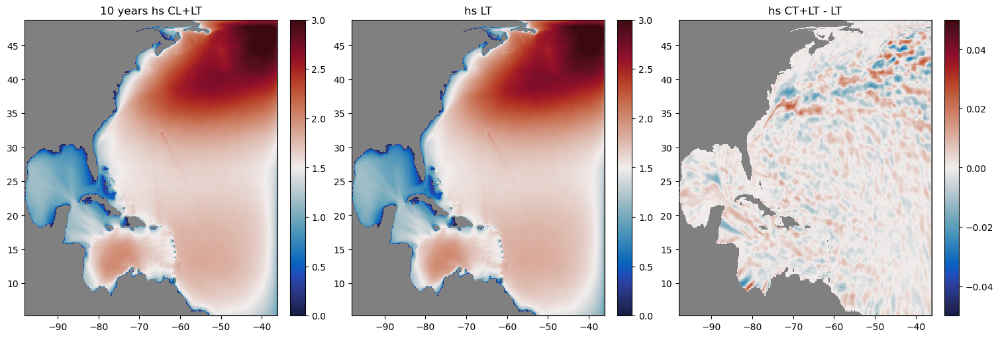

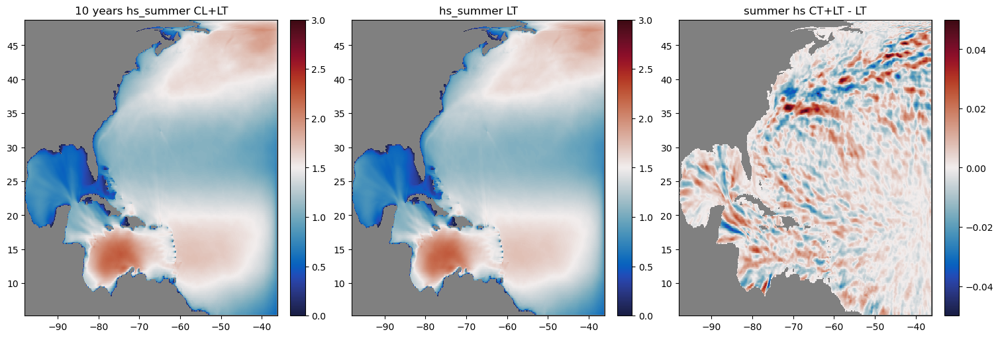

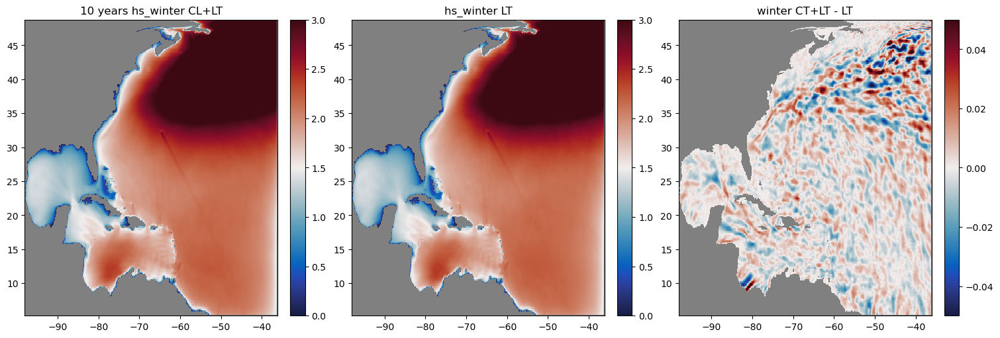

In [21]:
model_grid_x=model_grid_x_6
model_grid_y=model_grid_y_6

hs_6_all_ave=data_6_all['hs']
hs_winter_6_all_ave=W_data_6_all['hs']
hs_summer_6_all_ave=S_data_6_all['hs']

hs_6_wave_ave=data_6_wave['hs']
hs_winter_6_wave_ave=W_data_6_wave['hs']
hs_summer_6_wave_ave=S_data_6_wave['hs']


diff_hs_all_ave=hs_6_all_ave-hs_6_wave_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, hs_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('10 years hs CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, hs_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('hs LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_hs_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('hs CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_hs_summer_all_ave=hs_summer_6_all_ave-hs_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, hs_summer_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('10 years hs_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, hs_summer_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('hs_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_hs_summer_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('summer hs CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_hs_winter_all_ave=hs_winter_6_all_ave-hs_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, hs_winter_6_all_ave , cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[0].set_title('10 years hs_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, hs_winter_6_wave_ave, cmap=cmap, shading='auto',vmin=0,vmax=3)
axes[1].set_title('hs_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_hs_winter_all_ave, cmap=cmap, shading='auto',vmin=-0.05,vmax=0.05)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

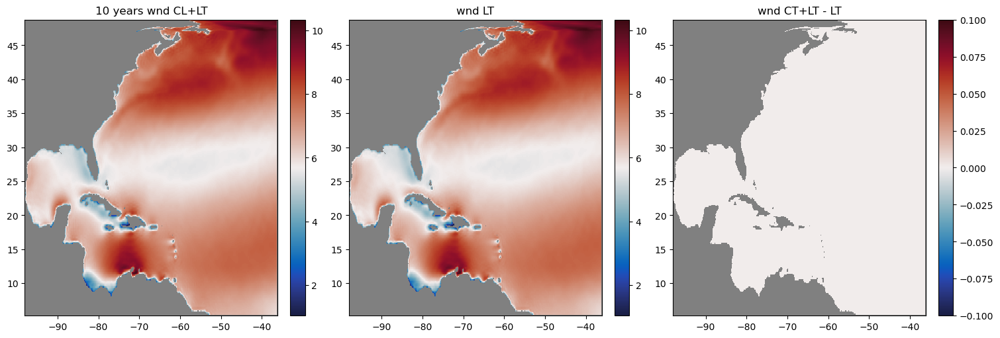

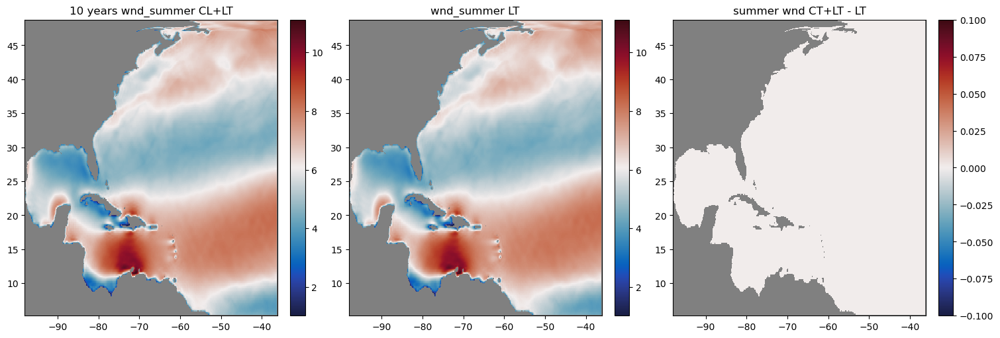

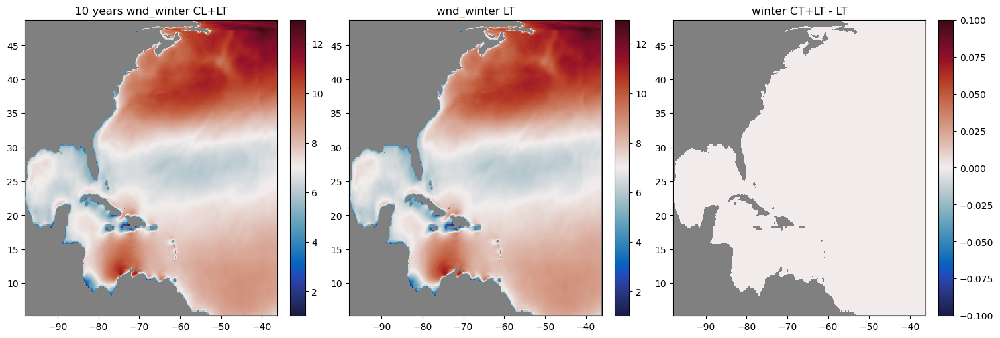

In [23]:
model_grid_x=model_grid_x_6
model_grid_y=model_grid_y_6

wnd_6_all_ave=data_6_all['wnd']
wnd_winter_6_all_ave=W_data_6_all['wnd']
wnd_summer_6_all_ave=S_data_6_all['wnd']

wnd_6_wave_ave=data_6_wave['wnd']
wnd_winter_6_wave_ave=W_data_6_wave['wnd']
wnd_summer_6_wave_ave=S_data_6_wave['wnd']


diff_wnd_all_ave=wnd_6_all_ave-wnd_6_wave_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, wnd_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years wnd CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, wnd_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('wnd LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_wnd_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('wnd CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_wnd_summer_all_ave=wnd_summer_6_all_ave-wnd_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, wnd_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years wnd_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, wnd_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('wnd_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_wnd_summer_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('summer wnd CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_wnd_winter_all_ave=wnd_winter_6_all_ave-wnd_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, wnd_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years wnd_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, wnd_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('wnd_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_wnd_winter_all_ave, cmap=cmap, shading='auto')
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

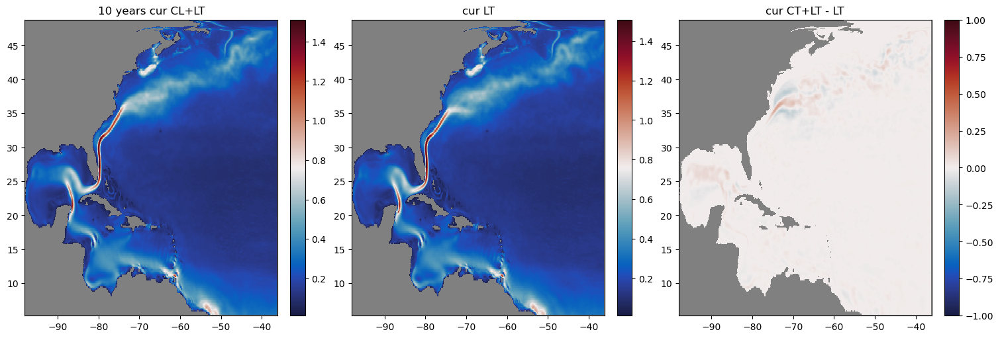

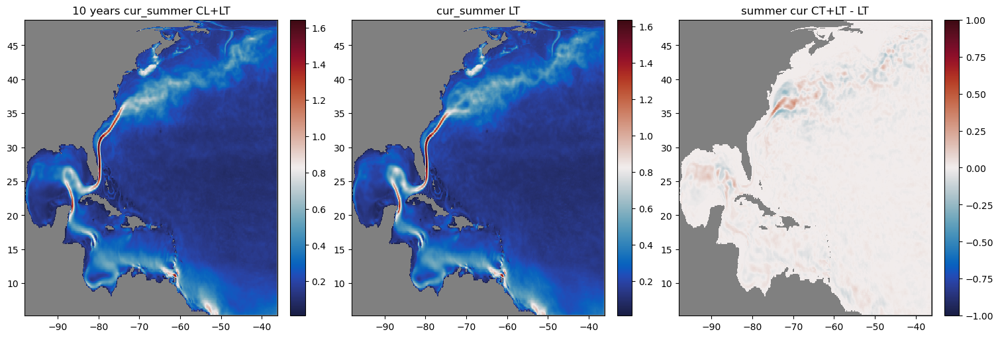

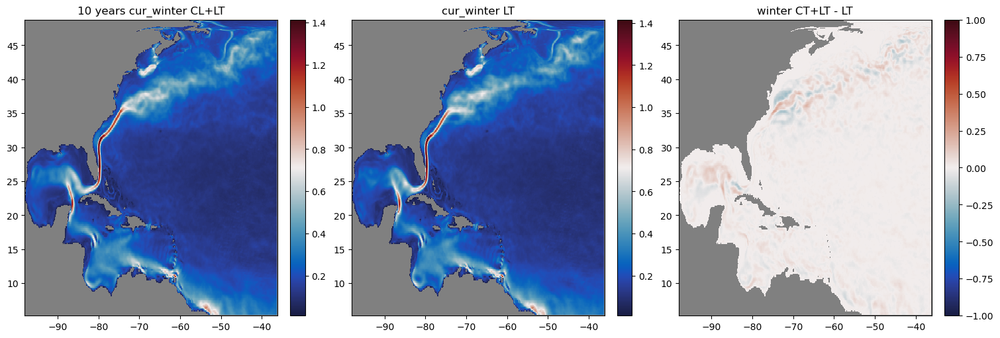

In [26]:
model_grid_x=model_grid_x_6
model_grid_y=model_grid_y_6

cur_6_all_ave=data_6_all['cur']
cur_winter_6_all_ave=W_data_6_all['cur']
cur_summer_6_all_ave=S_data_6_all['cur']

cur_6_wave_ave=data_6_wave['cur']
cur_winter_6_wave_ave=W_data_6_wave['cur']
cur_summer_6_wave_ave=S_data_6_wave['cur']


diff_cur_all_ave=cur_6_all_ave-cur_6_wave_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, cur_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years cur CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, cur_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('cur LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_cur_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('cur CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_cur_summer_all_ave=cur_summer_6_all_ave-cur_summer_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, cur_summer_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years cur_summer CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, cur_summer_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('cur_summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_cur_summer_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('summer cur CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()



diff_cur_winter_all_ave=cur_winter_6_all_ave-cur_winter_6_wave_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, cur_winter_6_all_ave , cmap=cmap, shading='auto')
axes[0].set_title('10 years cur_winter CL+LT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, cur_winter_6_wave_ave, cmap=cmap, shading='auto')
axes[1].set_title('cur_winter LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_cur_winter_all_ave, cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[2].set_title('winter CT+LT - LT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()